In [ ]:
import zipfile as zf
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
%matplotlib inline
from collections import Counter
from sklearn.impute import KNNImputer
from sklearn.preprocessing import LabelEncoder

In [ ]:
df = pd.read_csv('archive (1).zip',compression='zip')
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [ ]:
df.shape

(145460, 23)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [ ]:
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000


In [ ]:
df.isnull().sum()

Date                 0
Location             0
MinTemp           1485
MaxTemp           1261
Rainfall          3261
Evaporation      62790
Sunshine         69835
WindGustDir      10326
WindGustSpeed    10263
WindDir9am       10566
WindDir3pm        4228
WindSpeed9am      1767
WindSpeed3pm      3062
Humidity9am       2654
Humidity3pm       4507
Pressure9am      15065
Pressure3pm      15028
Cloud9am         55888
Cloud3pm         59358
Temp9am           1767
Temp3pm           3609
RainToday         3261
RainTomorrow      3267
dtype: int64

In [ ]:
num_features = [feature for feature in df.columns if df[feature].dtype=='float']

print("there are {} numerical features-\n ".format(len(num_features)))
print("Columns with numerical features are-\n",num_features)

there are 16 numerical features-
 
Columns with numerical features are-
 ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']


In [ ]:
cat_features = [feature for feature in df.columns if df[feature].dtype=='O']

print("there are {} categorical features-\n ".format(len(cat_features)))
print("Columns with categorical features are-\n",cat_features)

there are 7 categorical features-
 
Columns with categorical features are-
 ['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


In [ ]:
sns.set_style('darkgrid')
matplotlib.rcParams['font.size']=14
matplotlib.rcParams['figure.figsize']=(10,6)


<Figure size 1000x600 with 0 Axes>

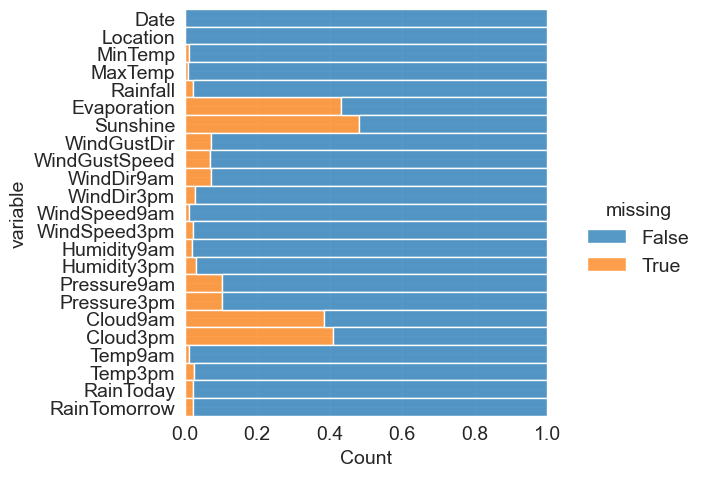

In [ ]:

plt.figure(figsize=(10, 6))
sns.displot(
    data=df.isna().melt(value_name="missing"),
    y="variable",
    hue="missing",
    multiple="fill",
    aspect=1.20
)
plt.show()


In [ ]:
df['RainTomorrow'].unique()

array(['No', 'Yes', nan], dtype=object)

In [ ]:
df[df['RainTomorrow']=="No"].shape

(110316, 23)

In [ ]:
df[df['RainTomorrow']=="Yes"].shape

(31877, 23)

In [ ]:
df['RainTomorrow'].isnull().sum()

3267

In [ ]:
df['RainToday'].isnull().sum()

3261

In [ ]:
missing = df.isnull().sum().sort_values(ascending=False)
missing_per = (missing/len(df))*100
pd.DataFrame({"Missing_Records":missing,"percentage of missing data":missing_per.values})

,Missing_Records,percentage of missing data
Sunshine,69835,48.009762
Evaporation,62790,43.166506
Cloud3pm,59358,40.807095
Cloud9am,55888,38.421559
Pressure9am,15065,10.356799
Pressure3pm,15028,10.331363
WindDir9am,10566,7.263853
WindGustDir,10326,7.098859
WindGustSpeed,10263,7.055548
Humidity3pm,4507,3.098446


In [ ]:
# sns.pairplot(df)

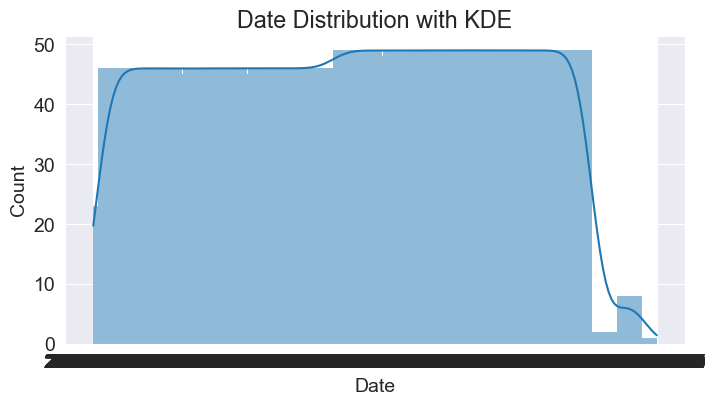

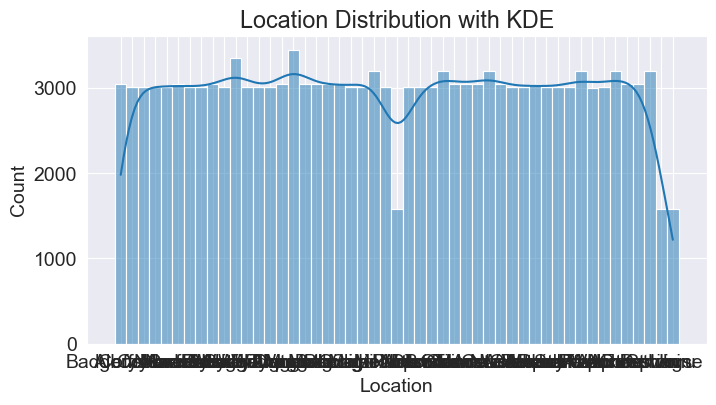

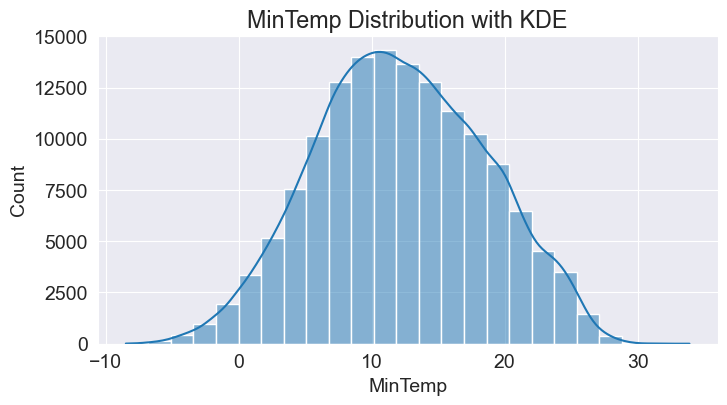

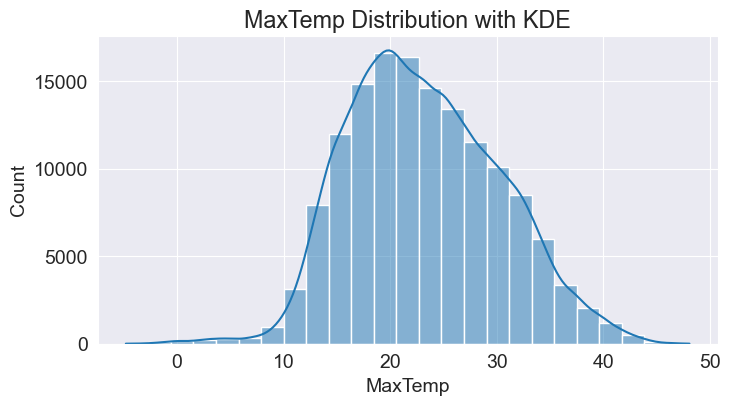

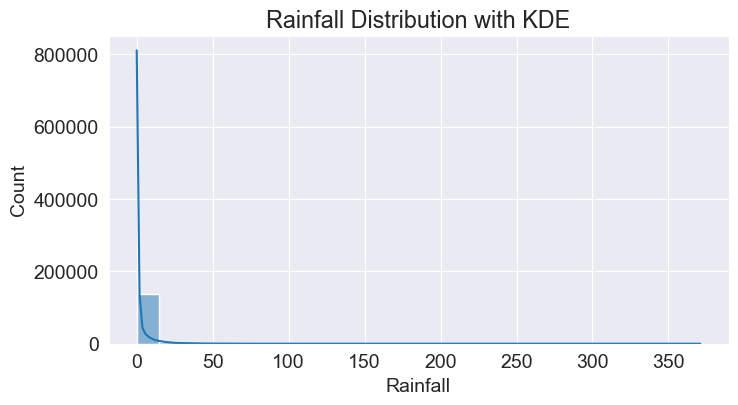

...

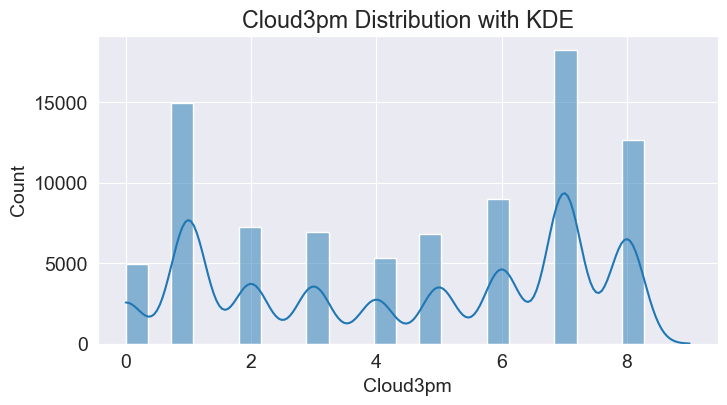

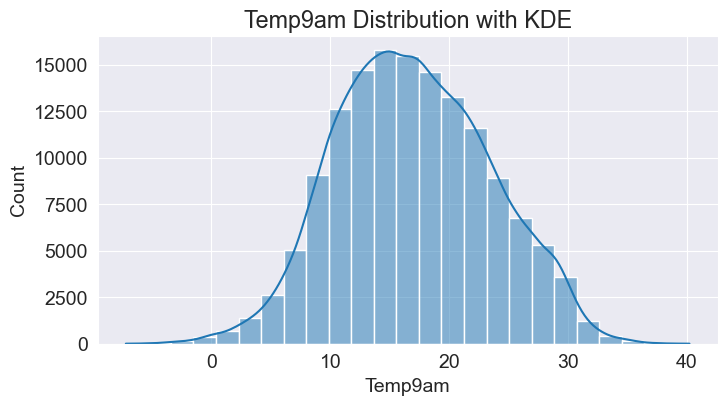

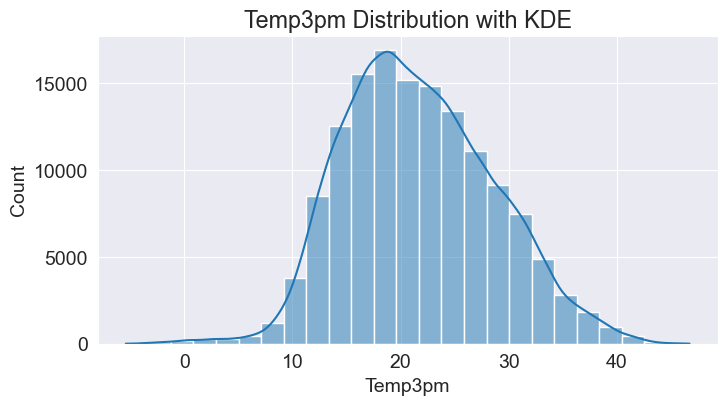

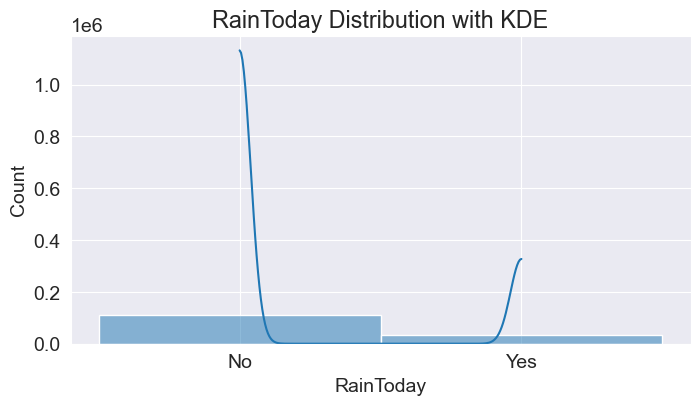

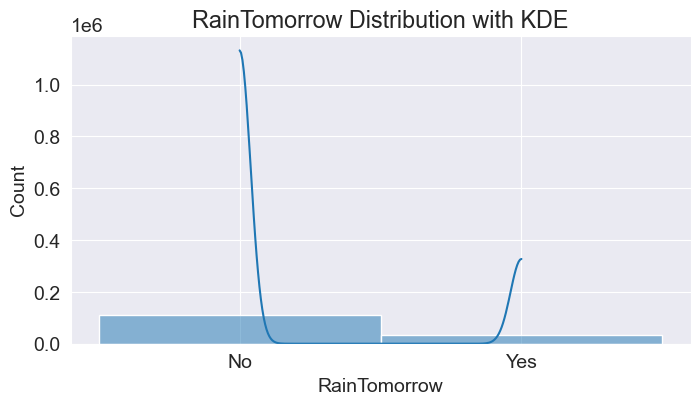

In [ ]:
for feature in df.columns:
    plt.figure(figsize=(8, 4))
    sns.histplot(df[feature], bins=25, kde=True)
    plt.xlabel(feature)
    plt.ylabel("Count")
    plt.title(f"{feature} Distribution with KDE")
    plt.show()

In [ ]:
data=df.copy()

In [ ]:
columns_to_exclude = ['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']
filtered_data = data.drop(columns=columns_to_exclude)


C:\Users\Dell\AppData\Local\Temp\ipykernel_24444\2058061655.py:8: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


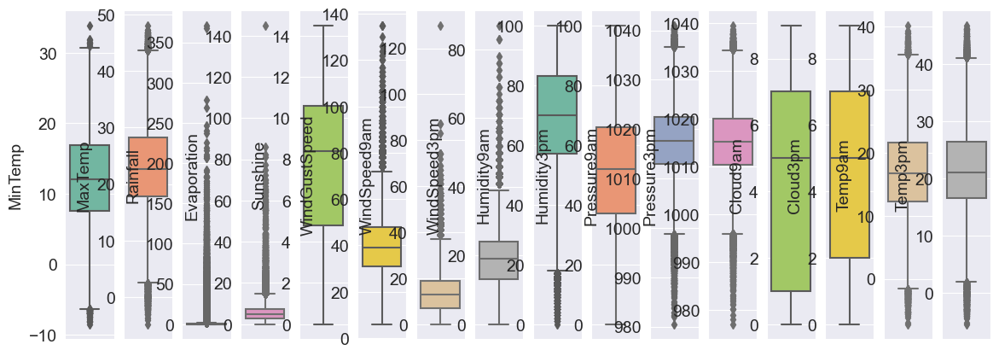

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=len(filtered_data.columns), figsize=(14, 5))
colors = sns.color_palette('Set2', n_colors=len(filtered_data.columns))

for i, column in enumerate(filtered_data.columns):
    sns.boxplot(y=filtered_data[column], ax=axes[i], color=colors[i % len(colors)])
    axes[i].set_xlabel(None)

plt.tight_layout()
plt.show()

In [ ]:
data1=df.copy()

In [ ]:
data2= data1.dropna(subset=['RainToday','RainTomorrow'])

In [ ]:
data2.shape

(140787, 23)

In [ ]:
data2[data2['RainTomorrow']=="No"].shape

(109586, 23)

In [ ]:
data2[data2['RainTomorrow']=="Yes"].shape

(31201, 23)

In [ ]:
def calculate_percentage_of_yes_no(data, column_name='RainTomorrow'):
    value_counts = data[column_name].value_counts(normalize=True) * 100
    yes_percentage = value_counts.get('Yes', 0)
    no_percentage = value_counts.get('No', 0)
    print(f"Percentage of 'Yes': {yes_percentage:.2f}%")
    print(f"Percentage of 'No': {no_percentage:.2f}%")
    return {'Yes': yes_percentage, 'No': no_percentage}
percentages = calculate_percentage_of_yes_no(data2, 'RainTomorrow')
print(percentages)


Percentage of 'Yes': 22.16%
Percentage of 'No': 77.84%
{'Yes': 22.161847329654016, 'No': 77.83815267034598}


In [ ]:
 px.histogram(data2,x="Location",title="Location vs Rainy Days",color="RainToday")

In [ ]:
px.histogram(data2,x="Temp3pm",title="Temp. at 3pm vs RainTomorrow",color="RainTomorrow")

In [ ]:
#mean temperature at 3pm depending on RainTomorrow
print("mean temp when it rains tomorrow")
print(data2[["RainTomorrow","Temp3pm"]].groupby("RainTomorrow").mean())

mean temp when it rains tomorrow
                Temp3pm
RainTomorrow           
No            22.405090
Yes           19.181358


In [ ]:
px.histogram(data2,x="RainTomorrow",color="RainToday",title="RainTomorrow vs RainToday")


In [ ]:
px.scatter(data2.sample(2000),title="Min.Temp vs Max.Temp",x="MinTemp",y="MaxTemp",color="RainToday")

In [ ]:
px.scatter(data2.sample(2000),title="Temp (3 pm) vs Humidity (3 pm) " , x="Temp3pm",y='Humidity3pm',color='RainTomorrow')

In [ ]:
data2.drop(['Cloud9am', 'Cloud3pm','Evaporation','Sunshine'], axis=1)

,Date,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,2017-06-20,Uluru,3.5,21.8,0.0,E,31.0,ESE,E,15.0,13.0,59.0,27.0,1024.7,1021.2,9.4,20.9,No,No
145455,2017-06-21,Uluru,2.8,23.4,0.0,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,10.1,22.4,No,No
145456,2017-06-22,Uluru,3.6,25.3,0.0,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,10.9,24.5,No,No
145457,2017-06-23,Uluru,5.4,26.9,0.0,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,12.5,26.1,No,No


In [ ]:
data1.dropna(subset=['RainToday','RainTomorrow'], inplace = True)

In [ ]:
data1.drop(['Cloud9am', 'Cloud3pm','Evaporation','Sunshine'], axis=1, inplace=True)

<Figure size 1000x600 with 0 Axes>

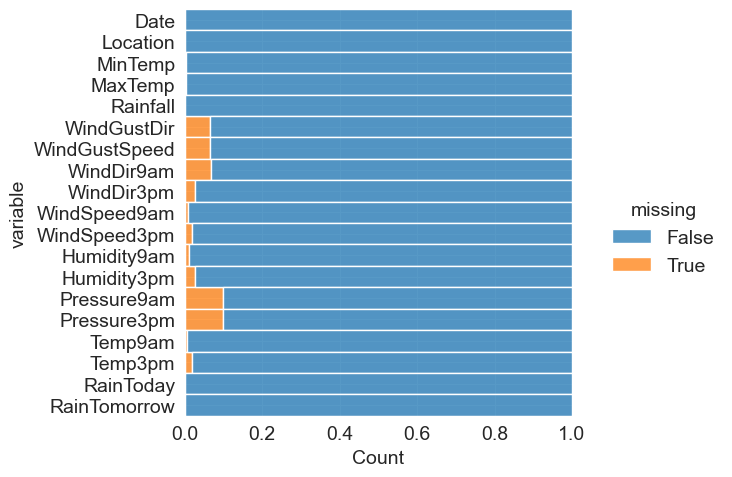

In [ ]:
plt.figure(figsize=(10,6))
sns.displot( data=data1.isna().melt(value_name="missing"), y="variable", hue="missing", multiple="fill", aspect=1.25 )

In [ ]:
data1['Date'] = pd.to_datetime(data1['Date'])
data1['Year'] = data1['Date'].dt.year
data1['Month'] = data1['Date'].dt.month
data1.drop('Date',inplace=True, axis=1)
data1

,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month
0,Albury,13.4,22.9,0.6,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,16.9,21.8,No,No,2008,12
1,Albury,7.4,25.1,0.0,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,17.2,24.3,No,No,2008,12
2,Albury,12.9,25.7,0.0,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,21.0,23.2,No,No,2008,12
3,Albury,9.2,28.0,0.0,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,18.1,26.5,No,No,2008,12
4,Albury,17.5,32.3,1.0,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,17.8,29.7,No,No,2008,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,Uluru,3.5,21.8,0.0,E,31.0,ESE,E,15.0,13.0,59.0,27.0,1024.7,1021.2,9.4,20.9,No,No,2017,6
145455,Uluru,2.8,23.4,0.0,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,10.1,22.4,No,No,2017,6
145456,Uluru,3.6,25.3,0.0,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,10.9,24.5,No,No,2017,6
145457,Uluru,5.4,26.9,0.0,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,12.5,26.1,No,No,2017,6


<Axes: xlabel='Year', ylabel='count'>

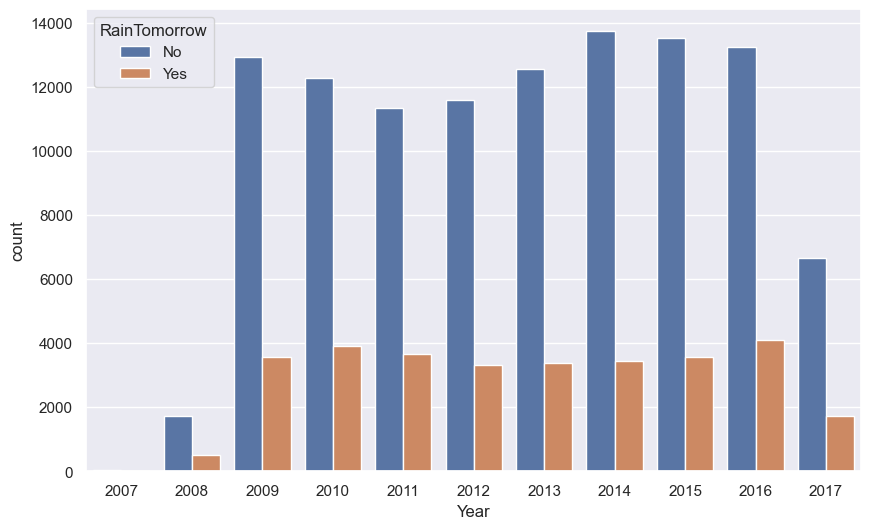

In [ ]:
sns.set_theme(style='darkgrid')
sns.countplot(x='Year', hue='RainTomorrow', data=data1)

<Axes: xlabel='Month', ylabel='count'>

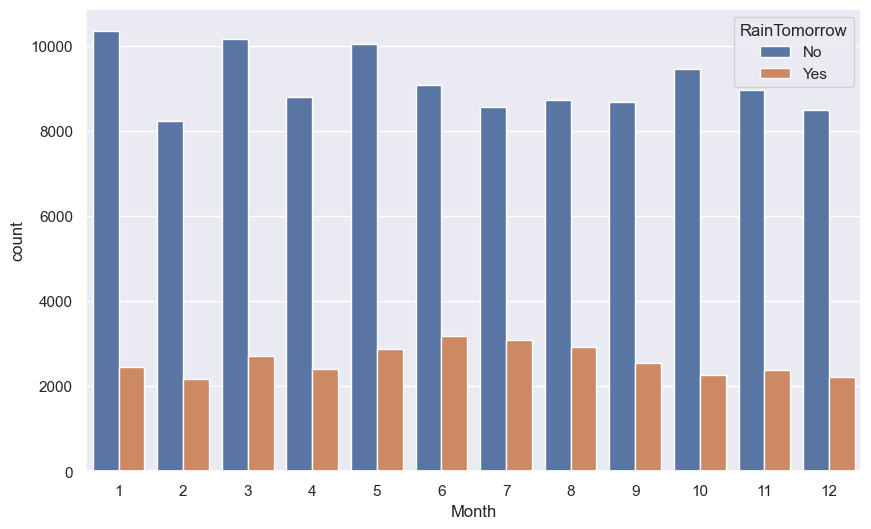

In [ ]:
sns.countplot(x='Month', hue='RainTomorrow', data=data1)

In [ ]:
#Listing columns with same datatype in vector
num_features = [column_name for column_name in data1.columns if data1[column_name].dtype=='float64']
cat_features = [column_name for column_name in data1.columns if data1[column_name].dtype=='object' or data1[column_name].dtype=='int64']
print("Columns with numerical datatypes-\n",(num_features))
print("columns with categorical datatypes-\n",(cat_features))

Columns with numerical datatypes-
 ['MinTemp', 'MaxTemp', 'Rainfall', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Temp9am', 'Temp3pm']
columns with categorical datatypes-
 ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow', 'Year', 'Month']


In [ ]:
#List of numbers of different categorical values in each categorical columns
print(data1[cat_features].nunique())

Location        49
WindGustDir     16
WindDir9am      16
WindDir3pm      16
RainToday        2
RainTomorrow     2
Year            11
Month           12
dtype: int64


In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
data1[num_features]=scaler.fit_transform(data1[num_features])
data1[num_features].head()

,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm
0,0.189757,-0.047104,-0.206727,0.296762,0.676275,0.610232,0.113996,-1.415339,-1.401098,-1.159562,-0.013403,0.015397
1,-0.747179,0.262125,-0.277606,0.296762,-1.124274,0.382909,-1.302317,-1.271158,-0.992926,-1.060065,0.032779,0.375743
2,0.111679,0.346460,-0.277606,0.444058,0.563741,0.837555,-1.617054,-1.030857,-1.415173,-0.932140,0.617756,0.217191
3,-0.466098,0.669744,-0.277606,-1.176193,-0.336533,-1.094689,-1.249861,-1.703700,-0.007682,-0.349372,0.171326,0.692849
4,0.829996,1.274146,-0.159474,0.075819,-0.786671,0.155586,0.691012,-0.886677,-0.964776,-1.315914,0.125144,1.154093


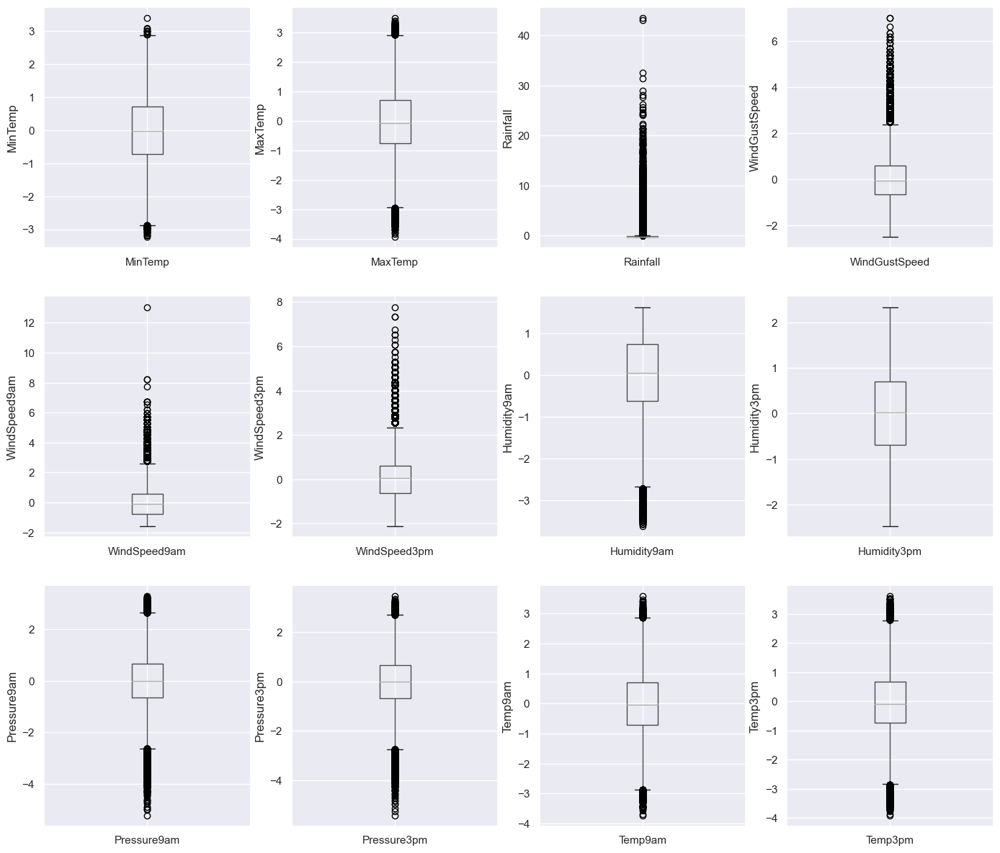

In [ ]:
#Creating boxplot for every numerical columns in data
plt.figure(figsize=(17, 20))
for i in range(len(num_features)):
    plt.subplot(4, 4, i+1)
    fig = data1.boxplot(column=num_features[i])
    fig.set_title("")
    fig.set_ylabel(num_features[i])
plt.show()

In [ ]:
print("count of `RainTomorrow` before removing outliers")
print(Counter(data1["RainTomorrow"]))

count of `RainTomorrow` before removing outliers
Counter({'No': 109586, 'Yes': 31201})


In [ ]:
#Removing outliers from numerical columns of the dataset
Q1 = data1[num_features].quantile(0.25)
Q3 = data1[num_features].quantile(0.75)
IQR = Q3-Q1
pd.concat([Q1,Q3,IQR],axis=1,keys=['Q1','Q2','IQR'])

,Q1,Q2,IQR
MinTemp,-0.715947,0.720687,1.436634
MaxTemp,-0.749897,0.711912,1.461809
Rainfall,-0.277606,-0.183101,0.094505
WindGustSpeed,-0.660658,0.591353,1.252012
WindSpeed9am,-0.786671,0.563741,1.350412
WindSpeed3pm,-0.640043,0.610232,1.250275
Humidity9am,-0.620389,0.743468,1.363857
Humidity3pm,-0.694436,0.699310,1.393746
Pressure9am,-0.655128,0.667914,1.323042
Pressure3pm,-0.690504,0.674027,1.364531


In [ ]:
for i, feature in enumerate(num_features):
    data1[feature] = np.where(data1[feature] > Q3[i] + 1.5 * IQR[i], Q3[i] + 1.5 * IQR[i], data1[feature])
    data1[feature] = np.where(data1[feature] < Q1[i] - 1.5 * IQR[i], Q1[i] - 1.5 * IQR[i], data1[feature])


In [ ]:
data1[num_features].describe()

,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm
count,140319.000000,140480.000000,140787.000000,131682.000000,139732.000000,138256.000000,139270.000000,1.372860e+05,127044.000000,127018.000000,140131.000000,138163.000000
mean,0.000027,0.000401,-0.220227,-0.014271,-0.010052,-0.009993,0.002823,4.968613e-17,0.003089,0.001995,0.000146,0.000339
std,0.999860,0.997879,0.093543,0.954742,0.966274,0.968561,0.991858,1.000004e+00,0.987676,0.991332,0.998926,0.996237
min,-2.870899,-2.942610,-0.277606,-2.501852,-1.574411,-2.117641,-2.666174,-2.472663e+00,-2.639691,-2.737301,-2.869011,-2.852965
25%,-0.715947,-0.749897,-0.277606,-0.660658,-0.786671,-0.640043,-0.620389,-6.944358e-01,-0.655128,-0.690504,-0.721532,-0.734125
50%,-0.028861,-0.089272,-0.277606,-0.071477,-0.111465,0.041925,0.061540,2.646732e-02,-0.007682,-0.008239,-0.044191,-0.085501
75%,0.720687,0.711912,-0.183101,0.591353,0.563741,0.610232,0.743468,6.993102e-01,0.667914,0.674027,0.710120,0.678435
max,2.875639,2.904625,-0.041343,2.469370,2.589359,2.485644,1.635221,2.333357e+00,2.652477,2.720824,2.857599,2.797275


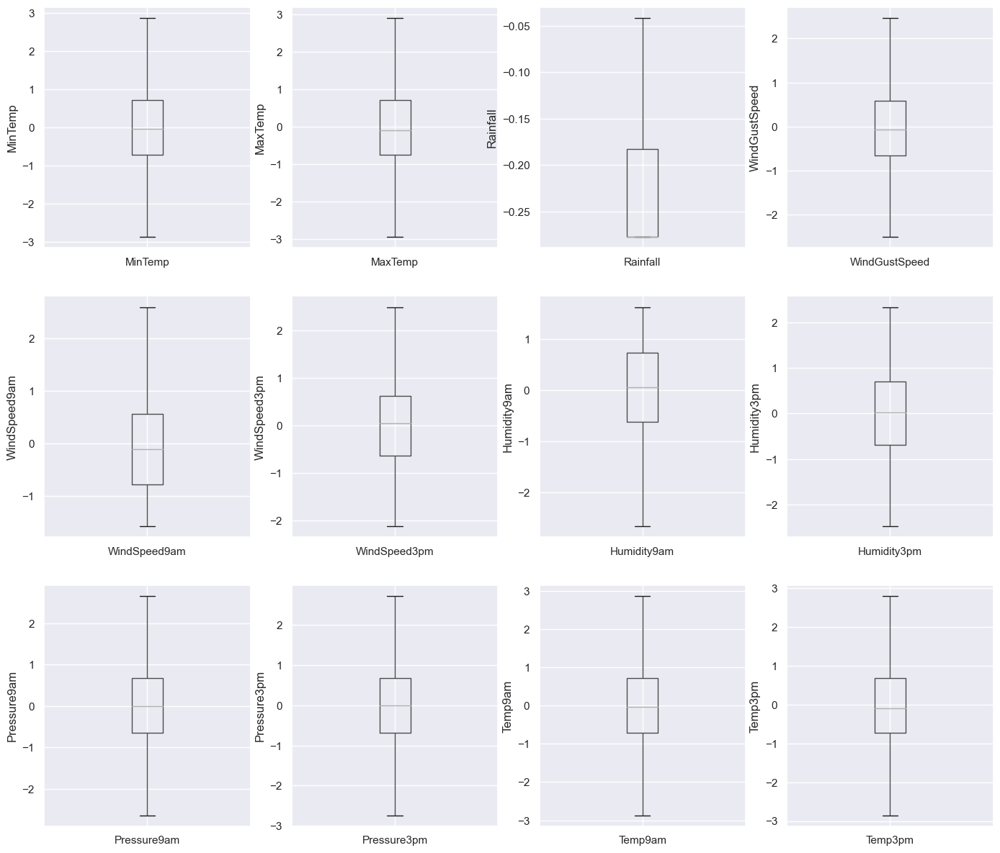

In [ ]:
#Boxplot after Replacing the outliers with the max and min value from the numerical columns from the dataset
plt.figure(figsize=(17, 20))
for i in range(len(num_features)):
    plt.subplot(4, 4, i+1)
    fig = data1.boxplot(column=num_features[i])
    fig.set_title("")
    fig.set_ylabel(num_features[i])
plt.show()

In [ ]:
print("Count of RainTomorrow values after removing the outliers")
print(Counter(data1['RainTomorrow']))

Count of RainTomorrow values after removing the outliers
Counter({'No': 109586, 'Yes': 31201})


In [ ]:
#Import the KNNImputer Class
imputer=KNNImputer(n_neighbors=5)
imputer=imputer.fit(data1[num_features])
data1[num_features]=imputer.transform(data1[num_features])
data1

,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month
0,Albury,0.189757,-0.047104,-0.206727,W,0.296762,W,WNW,0.676275,0.610232,0.113996,-1.415339,-1.401098,-1.159562,-0.013403,0.015397,No,No,2008,12
1,Albury,-0.747179,0.262125,-0.277606,WNW,0.296762,NNW,WSW,-1.124274,0.382909,-1.302317,-1.271158,-0.992926,-1.060065,0.032779,0.375743,No,No,2008,12
2,Albury,0.111679,0.346460,-0.277606,WSW,0.444058,W,WSW,0.563741,0.837555,-1.617054,-1.030857,-1.415173,-0.932140,0.617756,0.217191,No,No,2008,12
3,Albury,-0.466098,0.669744,-0.277606,NE,-1.176193,SE,E,-0.336533,-1.094689,-1.249861,-1.703700,-0.007682,-0.349372,0.171326,0.692849,No,No,2008,12
4,Albury,0.829996,1.274146,-0.159474,W,0.075819,ENE,NW,-0.786671,0.155586,0.691012,-0.886677,-0.964776,-1.315914,0.125144,1.154093,No,No,2008,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,Uluru,-1.356187,-0.201718,-0.277606,E,-0.660658,ESE,E,0.113604,-0.640043,-0.515477,-1.175038,0.991637,0.844593,-1.167962,-0.114328,No,No,2017,6
145455,Uluru,-1.465496,0.023175,-0.277606,E,-0.660658,SE,ENE,-0.111465,-0.867366,-0.935125,-1.319218,0.977562,0.716668,-1.060203,0.101880,No,No,2017,6
145456,Uluru,-1.340571,0.290236,-0.277606,NNW,-1.323488,SE,N,-0.111465,-1.094689,-0.672845,-1.463399,0.822738,0.546102,-0.937050,0.404571,No,No,2017,6
145457,Uluru,-1.059490,0.515130,-0.277606,N,-0.218772,SE,WNW,-0.561602,-1.094689,-0.830213,-1.319218,0.470865,0.219183,-0.690744,0.635193,No,No,2017,6


<Figure size 1000x600 with 0 Axes>

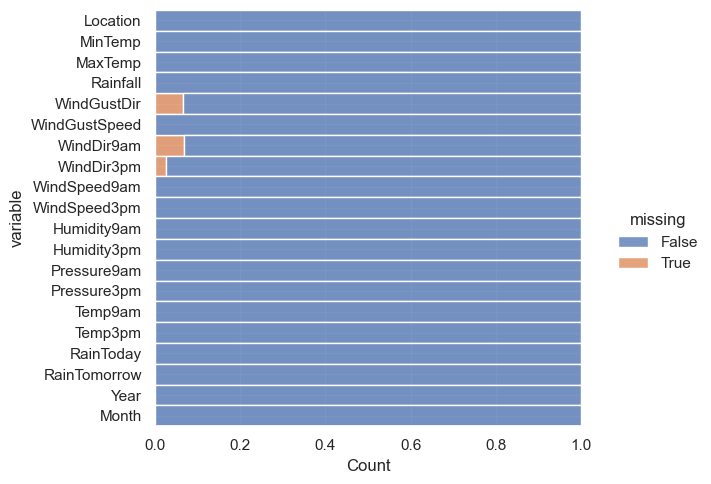

In [ ]:
plt.figure(figsize=(10,6))
sns.displot( data=data1.isna().melt(value_name="missing"), y="variable", hue="missing", multiple="fill", aspect=1.25 )

<Axes: >

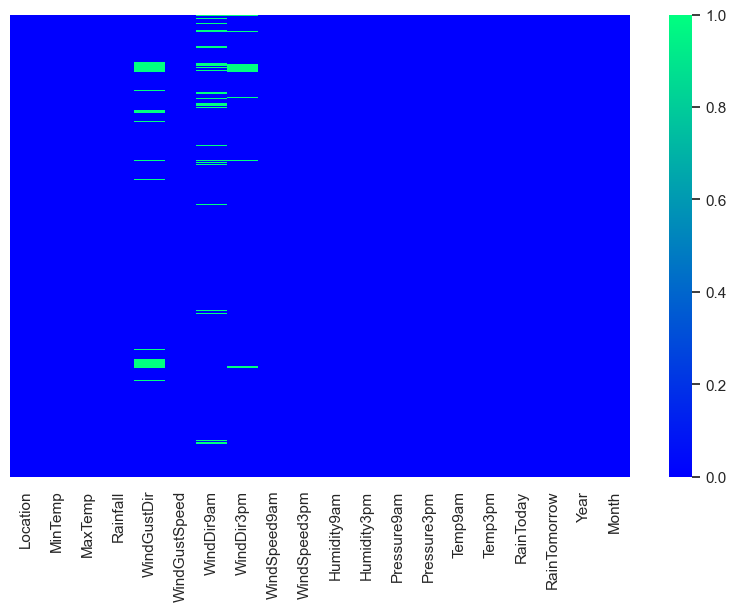

In [ ]:
sns.heatmap(data1.isnull(),yticklabels=False,cmap='winter')

In [ ]:
print(data1['WindGustDir'].mode())
print(data1['WindDir9am'].mode())
print(data1['WindDir3pm'].mode())

0    W
Name: WindGustDir, dtype: object
0    N
Name: WindDir9am, dtype: object
0    SE
Name: WindDir3pm, dtype: object


In [ ]:
data1['WindGustDir'].fillna('W',inplace=True)
data1['WindDir9am'].fillna('N',inplace=True)
data1['WindDir3pm'].fillna('SE',inplace=True)

<Axes: >

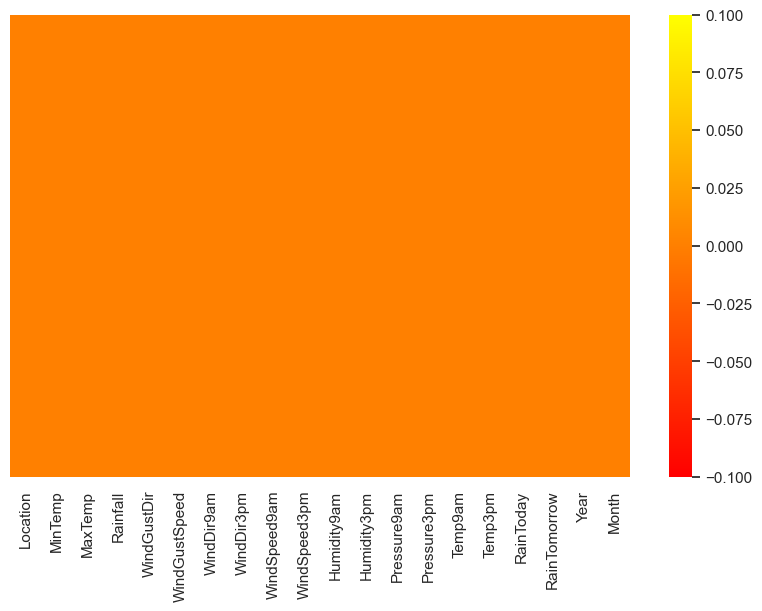

In [ ]:
sns.heatmap(data1.isnull(),yticklabels=False,cmap='autumn')

In [ ]:
def convert_categorical_features(feature):
    le = LabelEncoder()
    feature_encoded = le.fit_transform(feature)
    return(feature_encoded)

In [ ]:
for feature in cat_features:
    data1[feature]=convert_categorical_features(data1[feature])
data1[cat_features]

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow,Year,Month
0,2,13,13,14,0,0,1,11
1,2,14,6,15,0,0,1,11
2,2,15,13,15,0,0,1,11
3,2,4,9,0,0,0,1,11
4,2,13,1,7,0,0,1,11
...,...,...,...,...,...,...,...,...
145454,41,0,2,0,0,0,10,5
145455,41,0,9,1,0,0,10,5
145456,41,6,9,3,0,0,10,5
145457,41,3,9,14,0,0,10,5


In [ ]:
data1.describe()

,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month
count,140787.000000,140787.000000,140787.000000,140787.000000,140787.00000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000,140787.000000
mean,23.720074,-0.000026,0.000211,-0.220227,8.05362,-0.025568,7.006172,7.785740,-0.012325,-0.017832,0.005046,0.000735,0.027476,0.030438,-0.002415,0.003743,0.223423,0.221618,5.757492,5.403482
std,14.233401,0.998610,0.997165,0.093543,4.69313,0.940052,4.515248,4.547275,0.964043,0.963688,0.989473,0.994039,0.955491,0.960040,0.999574,0.993516,0.416541,0.415337,2.542272,3.426583
min,0.000000,-2.870899,-2.942610,-0.277606,0.00000,-2.501852,0.000000,0.000000,-1.574411,-2.117641,-2.666174,-2.472663,-2.639691,-2.737301,-2.869011,-2.852965,0.000000,0.000000,0.000000,0.000000
25%,11.000000,-0.715947,-0.749897,-0.277606,4.00000,-0.660658,3.000000,4.000000,-0.786671,-0.640043,-0.620389,-0.694436,-0.598828,-0.619435,-0.721532,-0.719711,0.000000,0.000000,4.000000,2.000000
50%,24.000000,-0.028861,-0.089272,-0.277606,9.00000,-0.100936,7.000000,8.000000,-0.111465,-0.185398,0.061540,0.026467,0.048618,0.048617,-0.044191,-0.071087,0.000000,0.000000,6.000000,5.000000
75%,36.000000,0.720687,0.697856,-0.183101,13.00000,0.561894,11.000000,12.000000,0.563741,0.610232,0.743468,0.651250,0.667914,0.674027,0.694726,0.678435,0.000000,0.000000,8.000000,8.000000
max,48.000000,2.875639,2.904625,-0.041343,15.00000,2.469370,15.000000,15.000000,2.589359,2.485644,1.635221,2.333357,2.652477,2.720824,2.857599,2.797275,1.000000,1.000000,10.000000,11.000000


In [ ]:
#Creating a copy of preprocessed dataset
df1=data1.copy()

In [ ]:
#creating a temporary dataframe for numerical features
temp_df = df1[num_features]
temp_df

,MinTemp,MaxTemp,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm
0,0.189757,-0.047104,-0.206727,0.296762,0.676275,0.610232,0.113996,-1.415339,-1.401098,-1.159562,-0.013403,0.015397
1,-0.747179,0.262125,-0.277606,0.296762,-1.124274,0.382909,-1.302317,-1.271158,-0.992926,-1.060065,0.032779,0.375743
2,0.111679,0.346460,-0.277606,0.444058,0.563741,0.837555,-1.617054,-1.030857,-1.415173,-0.932140,0.617756,0.217191
3,-0.466098,0.669744,-0.277606,-1.176193,-0.336533,-1.094689,-1.249861,-1.703700,-0.007682,-0.349372,0.171326,0.692849
4,0.829996,1.274146,-0.159474,0.075819,-0.786671,0.155586,0.691012,-0.886677,-0.964776,-1.315914,0.125144,1.154093
...,...,...,...,...,...,...,...,...,...,...,...,...
145454,-1.356187,-0.201718,-0.277606,-0.660658,0.113604,-0.640043,-0.515477,-1.175038,0.991637,0.844593,-1.167962,-0.114328
145455,-1.465496,0.023175,-0.277606,-0.660658,-0.111465,-0.867366,-0.935125,-1.319218,0.977562,0.716668,-1.060203,0.101880
145456,-1.340571,0.290236,-0.277606,-1.323488,-0.111465,-1.094689,-0.672845,-1.463399,0.822738,0.546102,-0.937050,0.404571
145457,-1.059490,0.515130,-0.277606,-0.218772,-0.561602,-1.094689,-0.830213,-1.319218,0.470865,0.219183,-0.690744,0.635193


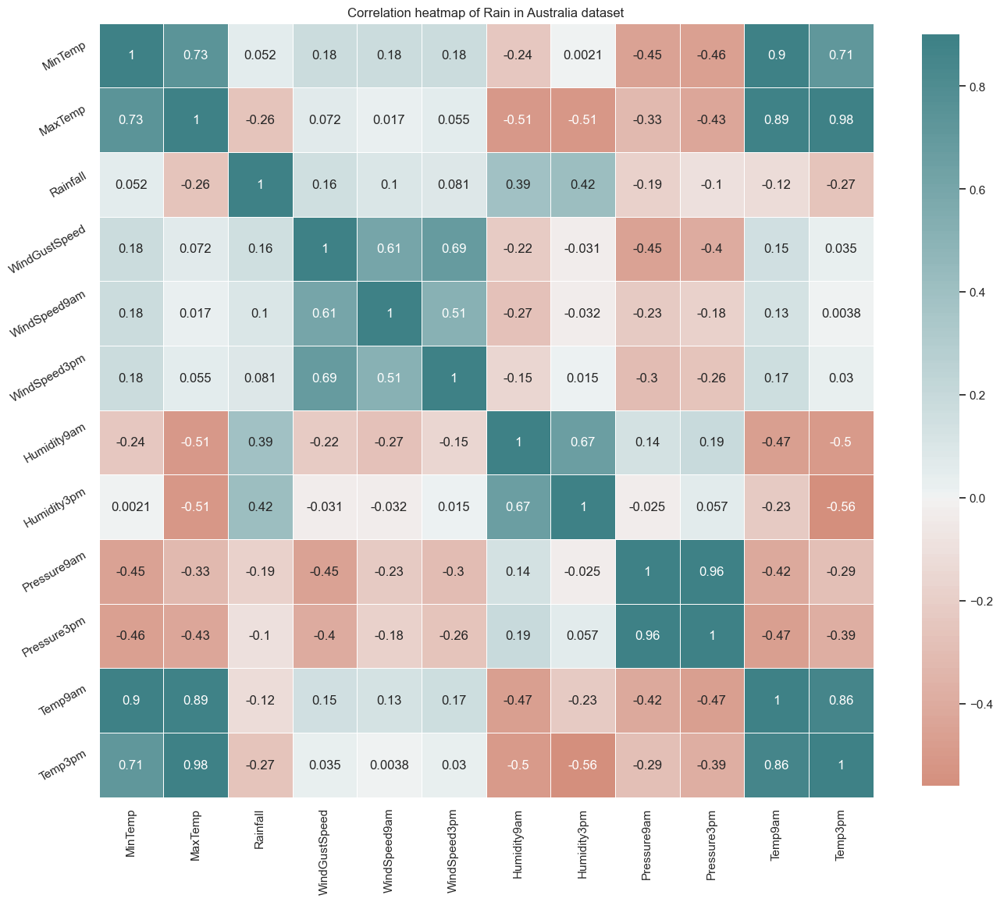

In [ ]:
#correlation matrix
plt.figure(figsize=(16,25))
plt.title('Correlation heatmap of Rain in Australia dataset')
ax = sns.heatmap(temp_df.corr(),annot=True,vmax=0.9,center=0, square=True,linewidths=0.5,cbar_kws={'shrink':.5},cmap=sns.diverging_palette(20,200,n=200))
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
ax.set_yticklabels(ax.get_yticklabels(),rotation=30)
plt.show()

In [ ]:
for column1 in temp_df.columns:
    for column2 in range(temp_df.columns.get_loc(column1) + 1, len(temp_df.columns)):
        if temp_df[column1].corr(temp_df.iloc[:, column2]) >= 0.9:
            print(f"{column1} and {temp_df.columns[column2]} are highly correlated")


MinTemp and Temp9am are highly correlated
MaxTemp and Temp3pm are highly correlated
Pressure9am and Pressure3pm are highly correlated


In [ ]:
morning_temp = (df1['MinTemp'] + df1['Temp9am']) / 2
noon_temp = (df1['MaxTemp'] + df1['Temp3pm']) / 2
new_pressure = (df1['Pressure9am'] + df1['Pressure3pm']) / 2

temp_df['Morning_temp'] = morning_temp
temp_df['Noon_temp'] = noon_temp
temp_df['New_pressure'] = new_pressure

temp_df.drop(["MinTemp", "Temp9am", "MaxTemp", "Temp3pm", "Pressure9am", "Pressure3pm"], inplace=True, axis=1)

temp_df.head()


C:\Users\Dell\AppData\Local\Temp\ipykernel_24444\2094724368.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Dell\AppData\Local\Temp\ipykernel_24444\2094724368.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Dell\AppData\Local\Temp\ipykernel_24444\2094724368.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Morning_temp,Noon_temp,New_pressure
0,-0.206727,0.296762,0.676275,0.610232,0.113996,-1.415339,0.088177,-0.015854,-1.280330
1,-0.277606,0.296762,-1.124274,0.382909,-1.302317,-1.271158,-0.357200,0.318934,-1.026495
2,-0.277606,0.444058,0.563741,0.837555,-1.617054,-1.030857,0.364717,0.281825,-1.173657
3,-0.277606,-1.176193,-0.336533,-1.094689,-1.249861,-1.703700,-0.147386,0.681297,-0.178527
4,-0.159474,0.075819,-0.786671,0.155586,0.691012,-0.886677,0.477570,1.214119,-1.140345


In [ ]:
df1['Morning_temp'] = morning_temp
df1['Noon_temp'] = noon_temp
df1['New_pressure'] = new_pressure
df1.drop(["MinTemp","Temp9am","MaxTemp","Temp3pm","Pressure9am","Pressure3pm"], inplace=True, axis=1)
df1.head()


,Location,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,RainToday,RainTomorrow,Year,Month,Morning_temp,Noon_temp,New_pressure
0,2,-0.206727,13,0.296762,13,14,0.676275,0.610232,0.113996,-1.415339,0,0,1,11,0.088177,-0.015854,-1.280330
1,2,-0.277606,14,0.296762,6,15,-1.124274,0.382909,-1.302317,-1.271158,0,0,1,11,-0.357200,0.318934,-1.026495
2,2,-0.277606,15,0.444058,13,15,0.563741,0.837555,-1.617054,-1.030857,0,0,1,11,0.364717,0.281825,-1.173657
3,2,-0.277606,4,-1.176193,9,0,-0.336533,-1.094689,-1.249861,-1.703700,0,0,1,11,-0.147386,0.681297,-0.178527
4,2,-0.159474,13,0.075819,1,7,-0.786671,0.155586,0.691012,-0.886677,0,0,1,11,0.477570,1.214119,-1.140345


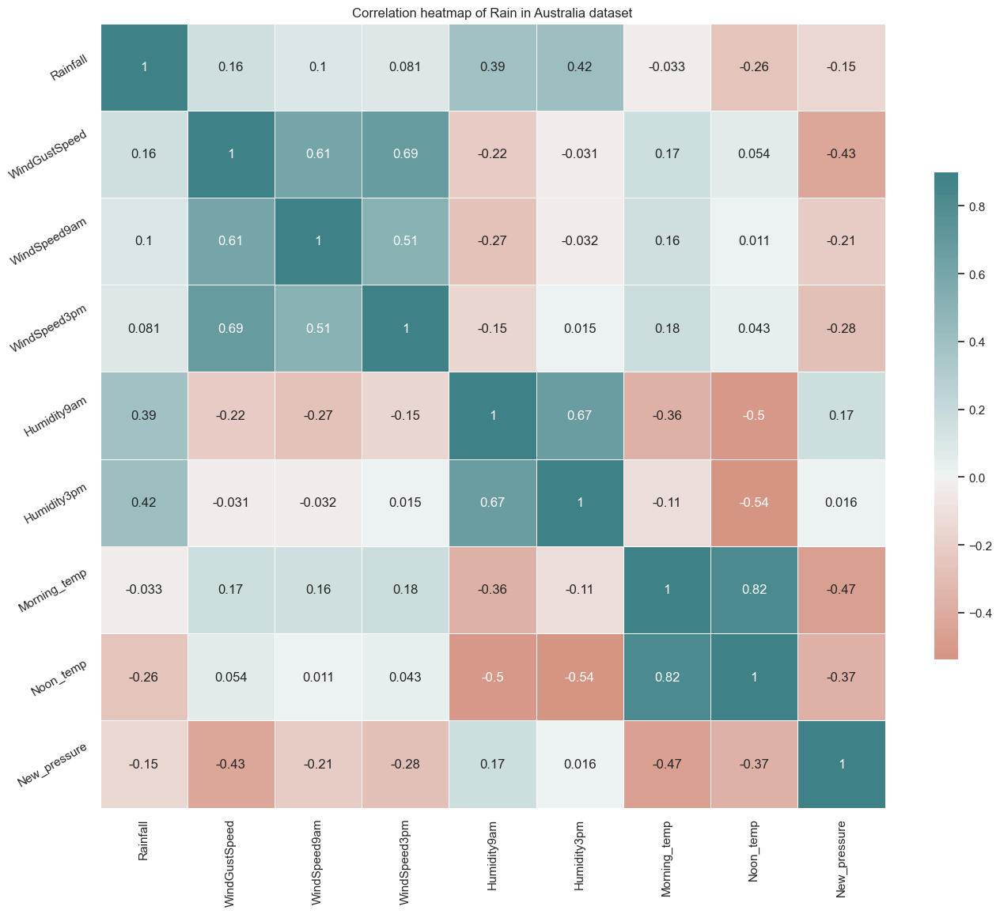

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(16,16))
plt.title('Correlation heatmap of Rain in Australia dataset')
ax = sns.heatmap(temp_df.corr(), annot=True, vmax=0.9, center=0, square=True, linewidths=0.5, cbar_kws={'shrink':0.5}, cmap=sns.diverging_palette(20,200,n=200))
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
ax.set_yticklabels(ax.get_yticklabels(), rotation=30)
plt.show()


In [ ]:
import pandas as pd
from statsmodels.stats.outliers_influence import variance_inflation_factor

def vif(Z3):
    vif_data = pd.DataFrame()
    vif_data["feature"] = Z3.columns
    vif_data["VIF"] = [variance_inflation_factor(np.array(Z3), i) for i in range(len(Z3.columns))]
    return vif_data


In [ ]:
vif_df = vif(temp_df)
vif_df.sort_values(by=['VIF'],ascending=False)

,feature,VIF
7,Noon_temp,9.595660
6,Morning_temp,7.773067
5,Humidity3pm,4.505601
1,WindGustSpeed,2.626146
4,Humidity9am,2.485387
3,WindSpeed3pm,1.976953
2,WindSpeed9am,1.807428
8,New_pressure,1.568566
0,Rainfall,1.054257


In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

def calculate_vif_(X, thresh=5.0):
    variables = list(range(X.shape[1]))
    dropped = True
    while dropped:
        dropped = False
        vif = [variance_inflation_factor(X.iloc[:, variables].values, ix) for ix in range(X.iloc[:, variables].shape[1])]
        maxloc = vif.index(max(vif))
        if max(vif) > thresh:
            print('dropping \'' + X.iloc[:, variables].columns[maxloc] + '\' at index: ' + str(maxloc))
            del variables[maxloc]
            dropped = True
    print('Remaining variables:')
    print(X.columns[variables])
    return X.iloc[:, variables]


In [ ]:
calculate_vif_(temp_df,5)

dropping 'Noon_temp' at index: 7
Remaining variables:
Index(['Rainfall', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm',
       'Humidity9am', 'Humidity3pm', 'Morning_temp', 'New_pressure'],
      dtype='object')


,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Morning_temp,New_pressure
0,-0.206727,0.296762,0.676275,0.610232,0.113996,-1.415339,0.088177,-1.280330
1,-0.277606,0.296762,-1.124274,0.382909,-1.302317,-1.271158,-0.357200,-1.026495
2,-0.277606,0.444058,0.563741,0.837555,-1.617054,-1.030857,0.364717,-1.173657
3,-0.277606,-1.176193,-0.336533,-1.094689,-1.249861,-1.703700,-0.147386,-0.178527
4,-0.159474,0.075819,-0.786671,0.155586,0.691012,-0.886677,0.477570,-1.140345
...,...,...,...,...,...,...,...,...
145454,-0.277606,-0.660658,0.113604,-0.640043,-0.515477,-1.175038,-1.262074,0.918115
145455,-0.277606,-0.660658,-0.111465,-0.867366,-0.935125,-1.319218,-1.262849,0.847115
145456,-0.277606,-1.323488,-0.111465,-1.094689,-0.672845,-1.463399,-1.138811,0.684420
145457,-0.277606,-0.218772,-0.561602,-1.094689,-0.830213,-1.319218,-0.875117,0.345024


In [ ]:
df1.drop(['Noon_temp'], axis=1, inplace=True)
temp_df.drop(['Noon_temp'], axis=1, inplace=True)
temp_df


C:\Users\Dell\AppData\Local\Temp\ipykernel_24444\3651423716.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Rainfall,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Morning_temp,New_pressure
0,-0.206727,0.296762,0.676275,0.610232,0.113996,-1.415339,0.088177,-1.280330
1,-0.277606,0.296762,-1.124274,0.382909,-1.302317,-1.271158,-0.357200,-1.026495
2,-0.277606,0.444058,0.563741,0.837555,-1.617054,-1.030857,0.364717,-1.173657
3,-0.277606,-1.176193,-0.336533,-1.094689,-1.249861,-1.703700,-0.147386,-0.178527
4,-0.159474,0.075819,-0.786671,0.155586,0.691012,-0.886677,0.477570,-1.140345
...,...,...,...,...,...,...,...,...
145454,-0.277606,-0.660658,0.113604,-0.640043,-0.515477,-1.175038,-1.262074,0.918115
145455,-0.277606,-0.660658,-0.111465,-0.867366,-0.935125,-1.319218,-1.262849,0.847115
145456,-0.277606,-1.323488,-0.111465,-1.094689,-0.672845,-1.463399,-1.138811,0.684420
145457,-0.277606,-0.218772,-0.561602,-1.094689,-0.830213,-1.319218,-0.875117,0.345024


In [ ]:
data1

,Location,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month
0,2,0.189757,-0.047104,-0.206727,13,0.296762,13,14,0.676275,0.610232,0.113996,-1.415339,-1.401098,-1.159562,-0.013403,0.015397,0,0,1,11
1,2,-0.747179,0.262125,-0.277606,14,0.296762,6,15,-1.124274,0.382909,-1.302317,-1.271158,-0.992926,-1.060065,0.032779,0.375743,0,0,1,11
2,2,0.111679,0.346460,-0.277606,15,0.444058,13,15,0.563741,0.837555,-1.617054,-1.030857,-1.415173,-0.932140,0.617756,0.217191,0,0,1,11
3,2,-0.466098,0.669744,-0.277606,4,-1.176193,9,0,-0.336533,-1.094689,-1.249861,-1.703700,-0.007682,-0.349372,0.171326,0.692849,0,0,1,11
4,2,0.829996,1.274146,-0.159474,13,0.075819,1,7,-0.786671,0.155586,0.691012,-0.886677,-0.964776,-1.315914,0.125144,1.154093,0,0,1,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,41,-1.356187,-0.201718,-0.277606,0,-0.660658,2,0,0.113604,-0.640043,-0.515477,-1.175038,0.991637,0.844593,-1.167962,-0.114328,0,0,10,5
145455,41,-1.465496,0.023175,-0.277606,0,-0.660658,9,1,-0.111465,-0.867366,-0.935125,-1.319218,0.977562,0.716668,-1.060203,0.101880,0,0,10,5
145456,41,-1.340571,0.290236,-0.277606,6,-1.323488,9,3,-0.111465,-1.094689,-0.672845,-1.463399,0.822738,0.546102,-0.937050,0.404571,0,0,10,5
145457,41,-1.059490,0.515130,-0.277606,3,-0.218772,9,14,-0.561602,-1.094689,-0.830213,-1.319218,0.470865,0.219183,-0.690744,0.635193,0,0,10,5


In [ ]:
num_features = [column_name for column_name in df1.columns if df1[column_name].dtype=='float64']
data1['Morning_temp']=morning_temp
data1['New_pressure']=new_pressure
data1.drop(['MinTemp','Temp9am','MaxTemp','Temp3pm','Pressure9am','Pressure3pm'],inplace=True , axis=1)
data1[num_features].info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 140787 entries, 0 to 145458
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Rainfall       140787 non-null  float64
 1   WindGustSpeed  140787 non-null  float64
 2   WindSpeed9am   140787 non-null  float64
 3   WindSpeed3pm   140787 non-null  float64
 4   Humidity9am    140787 non-null  float64
 5   Humidity3pm    140787 non-null  float64
 6   Morning_temp   140787 non-null  float64
 7   New_pressure   140787 non-null  float64
dtypes: float64(8)
memory usage: 9.7 MB


In [ ]:
#best variable selected using Stepwise Feature Selection
best_var = ['Location','Rainfall','WindGustSpeed','WindDir9am','WindSpeed9am','WindSpeed3pm','Humidity9am', 'Humidity3pm','RainToday','Year','Month','Morning_temp','New_pressure']

In [ ]:
#Splitting dataset into X(explanatory) and Y(target variable)
X = data1[best_var]
y=data1['RainTomorrow']

In [ ]:
# Split X and y into trainning testing sets
from sklearn.model_selection import train_test_split
X_train , X_test , y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0, stratify=y)

In [ ]:
X_train.shape , X_test.shape

((112629, 13), (28158, 13))

In [ ]:
from imblearn.over_sampling import SMOTE


In [ ]:
oversample= SMOTE()
X_train_smote , y_train_smote = oversample.fit_resample(X_train,y_train)

In [ ]:
from xgboost import XGBClassifier

In [ ]:
xgb_model=XGBClassifier()

In [ ]:
xgb_model.fit(X_train_smote,y_train_smote)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [ ]:
y_pred_xgb=xgb_model.predict(X_test)

In [ ]:
from sklearn.metrics import accuracy_score

In [ ]:
print(accuracy_score(y_test,y_pred_xgb))

0.8484267348533276


In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
RF_model=RandomForestClassifier()

In [ ]:
RF_model.fit(X_train_smote,y_train_smote)

RandomForestClassifier()

In [ ]:
y_pred_RF=RF_model.predict(X_test)

In [ ]:
print(accuracy_score(y_test,y_pred_RF))

0.8377725690745081


In [ ]:
# Make predictions on both training and test sets
y_pred_train = RF_model.predict(X_train_smote)
y_pred_test = RF_model.predict(X_test)

# Calculate accuracy for both training and test sets
train_accuracy = accuracy_score(y_train_smote, y_pred_train)
test_accuracy = accuracy_score(y_test, y_pred_test)


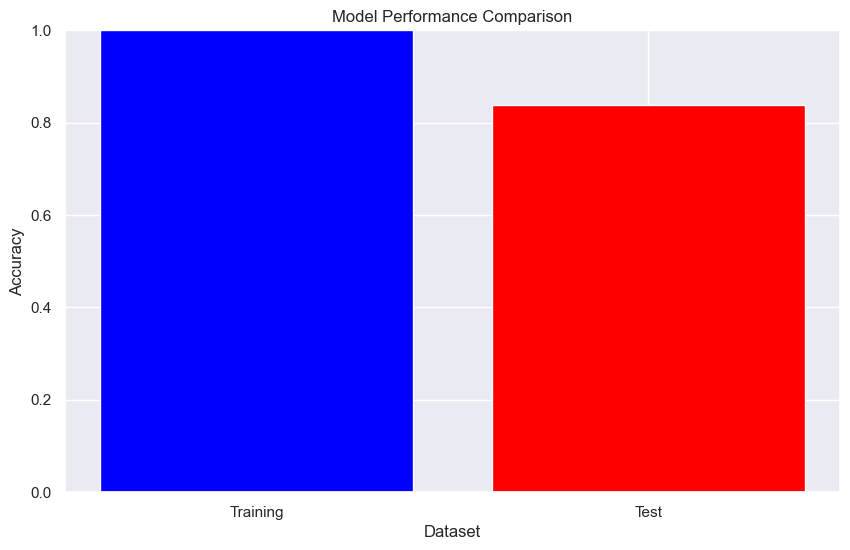

In [ ]:
plt.bar(['Training', 'Test'], [train_accuracy, test_accuracy], color=['blue', 'red'])
plt.title('Model Performance Comparison')
plt.xlabel('Dataset')
plt.ylabel('Accuracy')
plt.ylim(0, 1)
plt.show()

In [ ]:
from sklearn.metrics import confusion_matrix

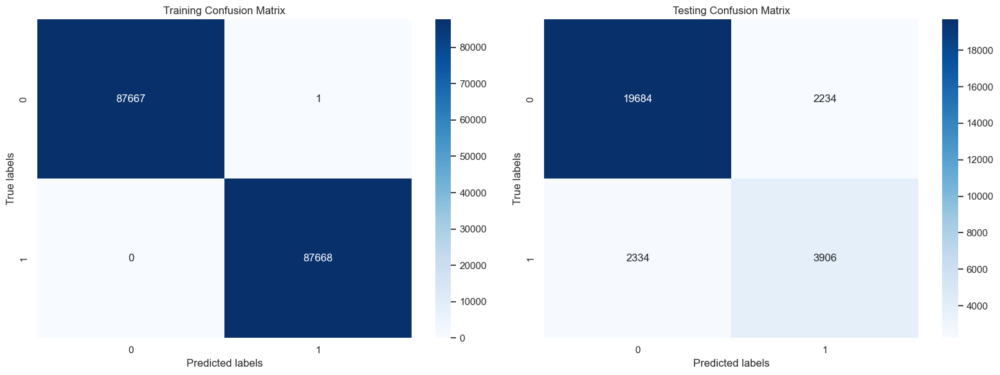

In [ ]:
conf_matrix_train = confusion_matrix(y_train_smote, y_pred_train)
conf_matrix_test = confusion_matrix(y_test, y_pred_test)

# Plot confusion matrices
plt.figure(figsize=(16, 6))

plt.subplot(1, 2, 1)
sns.heatmap(conf_matrix_train, annot=True, cmap='Blues', fmt='d', xticklabels=RF_model.classes_, yticklabels=RF_model.classes_)
plt.title('Training Confusion Matrix')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')

plt.subplot(1, 2, 2)
sns.heatmap(conf_matrix_test, annot=True, cmap='Blues', fmt='d', xticklabels=RF_model.classes_, yticklabels=RF_model.classes_)
plt.title('Testing Confusion Matrix')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')

plt.tight_layout()
plt.show()

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

In [ ]:
GB_model=GradientBoostingClassifier()

In [ ]:
GB_model.fit(X_train_smote,y_train_smote)

GradientBoostingClassifier()

In [ ]:
y_pred_GB=GB_model.predict(X_test)

In [ ]:
print(accuracy_score(y_pred_RF,y_pred_GB))

0.9303572696924497


In [ ]:
X_reset_index = X_train_smote.reset_index(drop=True)
y_reset_index = y_train_smote.reset_index(drop=True)

df_concatenated = pd.concat([X_reset_index, y_reset_index], axis=1)


In [ ]:
# random_10_rows = df_concatenated.sample(n=50)
# random_10_rows

In [ ]:
correct_mapping = all(df_concatenated.index == y_reset_index.index)

if correct_mapping:
    print("Every row of X is correctly mapped with the corresponding y.")
else:
    print("There is a mismatch between X and y.")

Every row of X is correctly mapped with the corresponding y.


In [ ]:
df_concatenated.shape

(175336, 14)

In [ ]:
sampled_dataframes = []
num_samples = int(0.8 * len(df_concatenated))
num_dataframes = 5

for i in range(num_dataframes):
    sampled_df = df_concatenated.sample(n=num_samples, replace=True, random_state=i)
    sampled_dataframes.append(sampled_df)

In [ ]:
from sklearn.tree import DecisionTreeClassifier

base_classifier = DecisionTreeClassifier()
classifiers = []

for i in range(5):
    X = sampled_dataframes[i].drop(columns=['RainTomorrow'])
    y = sampled_dataframes[i]['RainTomorrow']

    classifier = DecisionTreeClassifier()
    classifier.fit(X, y)

    classifiers.append(classifier)


In [ ]:
def aggregate_predictions(classifiers, test_data):
    all_predictions = []

    for classifier in classifiers:
        predictions = classifier.predict(test_data)
        all_predictions.append(predictions)

    ensemble_predictions = []

    for i in range(len(test_data)):
        sample_predictions = [pred[i] for pred in all_predictions]
        majority_vote = max(set(sample_predictions), key=sample_predictions.count)
        ensemble_predictions.append(majority_vote)

    return ensemble_predictions


In [ ]:
# predictions = aggregate_predictions(classifiers, X_test)

In [ ]:
# pd.DataFrame(predictions).shape

In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

predictions = aggregate_predictions(classifiers, X_test)

accuracy = accuracy_score(y_test, predictions)
print("Accuracy:", accuracy)

conf_matrix = confusion_matrix(y_test, predictions)
print("Confusion Matrix:")
print(conf_matrix)

class_report = classification_report(y_test, predictions)
print("Classification Report:")
print(class_report)



Accuracy: 0.8078343632360253
Confusion Matrix:
[[19012  2906]
 [ 2505  3735]]
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.87      0.88     21918
           1       0.56      0.60      0.58      6240

    accuracy                           0.81     28158
   macro avg       0.72      0.73      0.73     28158
weighted avg       0.81      0.81      0.81     28158



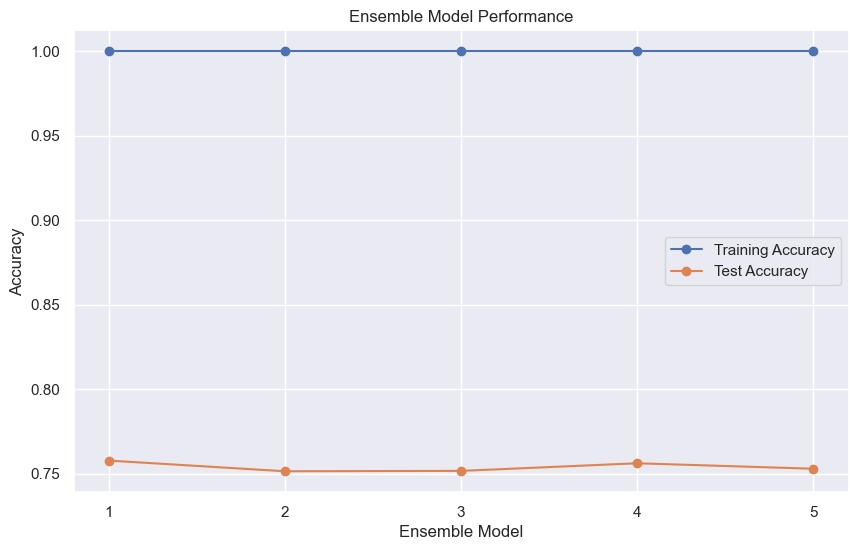

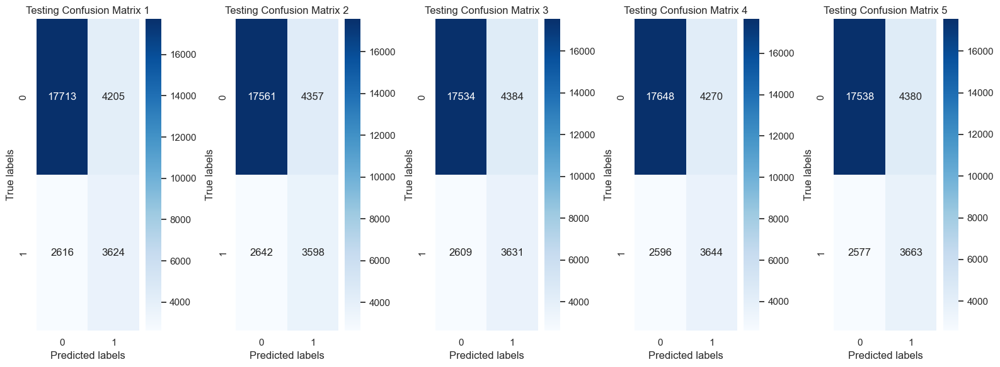

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, confusion_matrix
import seaborn as sns

def evaluate_ensemble(classifiers, sampled_dataframes, X_test, y_test):
    train_accuracies = []
    test_accuracies = []
    test_conf_matrices = []

    for i, clf in enumerate(classifiers):
        X_train_sampled = sampled_dataframes[i].drop(columns=['RainTomorrow'])
        y_train_sampled = sampled_dataframes[i]['RainTomorrow']

        train_pred = clf.predict(X_train_sampled)
        test_pred = clf.predict(X_test)

        train_accuracy = accuracy_score(y_train_sampled, train_pred)
        test_accuracy = accuracy_score(y_test, test_pred)

        train_accuracies.append(train_accuracy)
        test_accuracies.append(test_accuracy)

        test_conf_matrix = confusion_matrix(y_test, test_pred)
        test_conf_matrices.append(test_conf_matrix)

    return train_accuracies, test_accuracies, test_conf_matrices

# Evaluate the ensemble model
train_accuracies, test_accuracies, test_conf_matrices = evaluate_ensemble(classifiers, sampled_dataframes, X_test, y_test)

# Plotting the comparison graph for accuracies
plt.plot(range(1, num_dataframes + 1), train_accuracies, label='Training Accuracy', marker='o')
plt.plot(range(1, num_dataframes + 1), test_accuracies, label='Test Accuracy', marker='o')
plt.xlabel('Ensemble Model')
plt.ylabel('Accuracy')
plt.title('Ensemble Model Performance')
plt.xticks(range(1, num_dataframes + 1))
plt.legend()
plt.show()

# Plotting confusion matrices for testing dataset
plt.figure(figsize=(16, 6))

for i in range(num_dataframes):
    plt.subplot(1, num_dataframes, i + 1)
    sns.heatmap(test_conf_matrices[i], annot=True, cmap='Blues', fmt='d', xticklabels=RF_model.classes_, yticklabels=RF_model.classes_)
    plt.title(f'Testing Confusion Matrix {i+1}')
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')

plt.tight_layout()
plt.show()


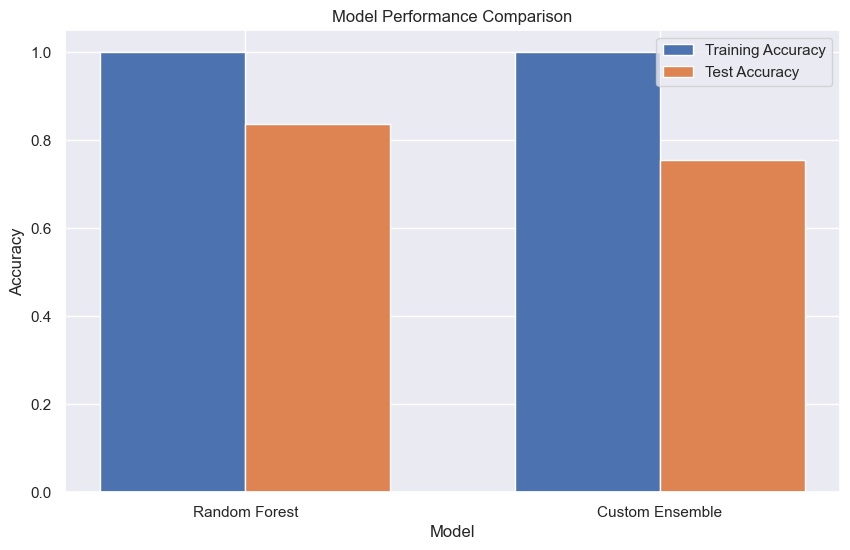

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Calculate accuracy for RF_model
RF_train_accuracy = accuracy_score(y_train, RF_model.predict(X_train))
RF_test_accuracy = accuracy_score(y_test, RF_model.predict(X_test))

# Calculate accuracy for the custom ensemble model
ensemble_train_accuracy = np.mean(train_accuracies)
ensemble_test_accuracy = np.mean(test_accuracies)

# Plotting the comparison graph for accuracies
labels = ['Random Forest', 'Custom Ensemble']
train_accuracies = [RF_train_accuracy, ensemble_train_accuracy]
test_accuracies = [RF_test_accuracy, ensemble_test_accuracy]

x = np.arange(len(labels))
width = 0.35

fig, ax = plt.subplots()
bars1 = ax.bar(x - width/2, train_accuracies, width, label='Training Accuracy')
bars2 = ax.bar(x + width/2, test_accuracies, width, label='Test Accuracy')

ax.set_xlabel('Model')
ax.set_ylabel('Accuracy')
ax.set_title('Model Performance Comparison')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()

plt.show()


In [ ]:
from sklearn.metrics import accuracy_score

# Calculate accuracy for RF_model
RF_train_accuracy = accuracy_score(y_train, RF_model.predict(X_train))
RF_test_accuracy = accuracy_score(y_test, RF_model.predict(X_test))

# Calculate accuracy for the custom ensemble model
ensemble_train_accuracy = np.mean(train_accuracies)
ensemble_test_accuracy = np.mean(test_accuracies)

# Print out the accuracy scores
print("Random Forest Model:")
print("Training Accuracy:", RF_train_accuracy)
print("Testing Accuracy:", RF_test_accuracy)

print("\nCustom Ensemble Model:")
print("Training Accuracy:", ensemble_train_accuracy)
print("Testing Accuracy:", ensemble_test_accuracy)


Random Forest Model:
Training Accuracy: 0.9999911212920296
Testing Accuracy: 0.8377725690745081

Custom Ensemble Model:
Training Accuracy: 0.9999955606460148
Testing Accuracy: 0.7958803892321897


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

best_accuracy = 0
best_num_dataframes = 0
best_classifiers = []

# Define the range of values for num_dataframes to search over
num_dataframes_values = [3, 4, 5, 6, 7,9,10,12,14,15,16,17,18,19,20]

for num_dataframes in num_dataframes_values:
    sampled_dataframes = []
    num_samples = int(0.8 * len(df_concatenated))

    for i in range(num_dataframes):
        sampled_df = df_concatenated.sample(n=num_samples, replace=True, random_state=i)
        sampled_dataframes.append(sampled_df)

    classifiers = []

    for i in range(num_dataframes):
        X = sampled_dataframes[i].drop(columns=['RainTomorrow'])
        y = sampled_dataframes[i]['RainTomorrow']

        classifier = DecisionTreeClassifier()
        classifier.fit(X, y)

        classifiers.append(classifier)

    predictions = aggregate_predictions(classifiers, X_test)
    accuracy = accuracy_score(y_test, predictions)

    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_num_dataframes = num_dataframes
        best_classifiers = classifiers

print("Best number of dataframes:", best_num_dataframes)
print("Best accuracy:", best_accuracy)

# Now you can use the best classifiers and the best number of dataframes for further analysis


Best number of dataframes: 20
Best accuracy: 0.8350379998579445


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

best_accuracy = 0
best_num_dataframes = 0
best_classifiers = []

# Define the range of values for num_dataframes to search over
num_dataframes_values = [21,22,23,24]

for num_dataframes in num_dataframes_values:
    sampled_dataframes = []
    num_samples = int(0.8 * len(df_concatenated))

    for i in range(num_dataframes):
        sampled_df = df_concatenated.sample(n=num_samples, replace=True, random_state=i)
        sampled_dataframes.append(sampled_df)

    classifiers = []

    for i in range(num_dataframes):
        X = sampled_dataframes[i].drop(columns=['RainTomorrow'])
        y = sampled_dataframes[i]['RainTomorrow']

        classifier = DecisionTreeClassifier()
        classifier.fit(X, y)

        classifiers.append(classifier)

    predictions = aggregate_predictions(classifiers, X_test)
    accuracy = accuracy_score(y_test, predictions)

    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_num_dataframes = num_dataframes
        best_classifiers = classifiers

print("Best number of dataframes:", best_num_dataframes)
print("Best accuracy:", best_accuracy)

# Now you can use the best classifiers and the best number of dataframes for further analysis


Best number of dataframes: 22
Best accuracy: 0.8372398607855671


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

best_accuracy = 0
best_num_dataframes = 0
best_classifiers = []

# Define the range of values for num_dataframes to search over
num_dataframes_values = [100]

for num_dataframes in num_dataframes_values:
    sampled_dataframes = []
    num_samples = int(0.8 * len(df_concatenated))

    for i in range(num_dataframes):
        sampled_df = df_concatenated.sample(n=num_samples, replace=True, random_state=i)
        sampled_dataframes.append(sampled_df)

    classifiers = []

    for i in range(num_dataframes):
        X = sampled_dataframes[i].drop(columns=['RainTomorrow'])
        y = sampled_dataframes[i]['RainTomorrow']

        classifier = DecisionTreeClassifier()
        classifier.fit(X, y)

        classifiers.append(classifier)

    predictions = aggregate_predictions(classifiers, X_test)
    accuracy = accuracy_score(y_test, predictions)

    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_num_dataframes = num_dataframes
        best_classifiers = classifiers

print("Best number of dataframes:", best_num_dataframes)
print("Best accuracy:", best_accuracy)

# Now you can use the best classifiers and the best number of dataframes for further analysis


Best number of dataframes: 100
Best accuracy: 0.8370622913559201


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

best_accuracy = 0
best_num_dataframes = 0
best_classifiers = []

# Define the range of values for num_dataframes to search over
num_dataframes_values = [110]

for num_dataframes in num_dataframes_values:
    sampled_dataframes = []
    num_samples = int(0.8 * len(df_concatenated))

    for i in range(num_dataframes):
        sampled_df = df_concatenated.sample(n=num_samples, replace=True, random_state=i)
        sampled_dataframes.append(sampled_df)

    classifiers = []

    for i in range(num_dataframes):
        X = sampled_dataframes[i].drop(columns=['RainTomorrow'])
        y = sampled_dataframes[i]['RainTomorrow']

        classifier = DecisionTreeClassifier()
        classifier.fit(X, y)

        classifiers.append(classifier)

    predictions = aggregate_predictions(classifiers, X_test)
    accuracy = accuracy_score(y_test, predictions)

    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_num_dataframes = num_dataframes
        best_classifiers = classifiers

print("Best number of dataframes:", best_num_dataframes)
print("Best accuracy:", best_accuracy)

# Now you can use the best classifiers and the best number of dataframes for further analysis


Best number of dataframes: 110
Best accuracy: 0.8378080829604375


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

best_accuracy = 0
best_num_dataframes = 0
best_classifiers = []

# Define the range of values for num_dataframes to search over
num_dataframes_values = [115]

for num_dataframes in num_dataframes_values:
    sampled_dataframes = []
    num_samples = int(0.8 * len(df_concatenated))

    for i in range(num_dataframes):
        sampled_df = df_concatenated.sample(n=num_samples, replace=True, random_state=i)
        sampled_dataframes.append(sampled_df)

    classifiers = []

    for i in range(num_dataframes):
        X = sampled_dataframes[i].drop(columns=['RainTomorrow'])
        y = sampled_dataframes[i]['RainTomorrow']

        classifier = DecisionTreeClassifier()
        classifier.fit(X, y)

        classifiers.append(classifier)

    predictions = aggregate_predictions(classifiers, X_test)
    accuracy = accuracy_score(y_test, predictions)

    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_num_dataframes = num_dataframes
        best_classifiers = classifiers

print("Best number of dataframes:", best_num_dataframes)
print("Best accuracy:", best_accuracy)

# Now you can use the best classifiers and the best number of dataframes for further analysis


Best number of dataframes: 115
Best accuracy: 0.8367781802684849


In [ ]:
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

sns.set()

In [ ]:
print(X_train_smote.shape)
print(y_train_smote.shape)

(175336, 13)
(175336,)


C:\Users\Dell\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



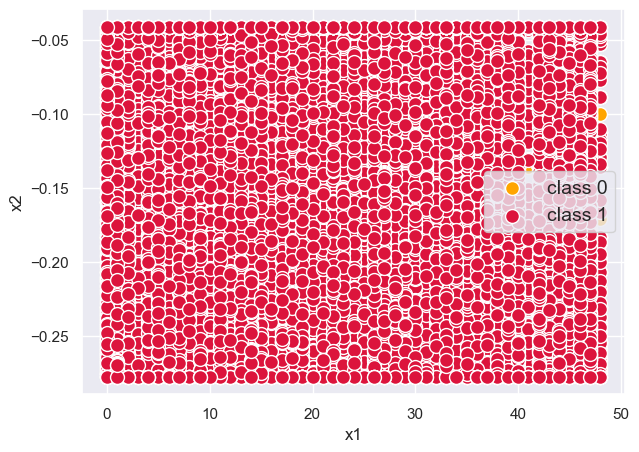

In [ ]:
x = X_train_smote.iloc[:, 0]
y = X_train_smote.iloc[:, 1]

plt.figure(figsize=(7, 5))
plt.scatter(x[y_train_smote.values==0], y[y_train_smote.values==0], c='orange', edgecolors='w', s=100, label='class 0')
plt.scatter(x[y_train_smote.values==1], y[y_train_smote.values==1], c='crimson', edgecolors='w', s=100, label='class 1')
plt.xlabel('x1')
plt.ylabel('x2')
plt.legend(fontsize=14)
plt.show()


In [ ]:
df2=df_concatenated.copy()

In [ ]:
print(Counter(df2['RainTomorrow']))

Counter({0: 87668, 1: 87668})


In [ ]:
num_samples = int(0.95 * len(df2))

In [ ]:
subset = df2.sample(n=num_samples, replace=True, random_state=42)

In [ ]:
print(Counter(subset['RainTomorrow']))

Counter({0: 83351, 1: 83218})


In [ ]:
num_1 = (subset['RainTomorrow'] == 1).sum()
num_0 = (subset['RainTomorrow'] == 0).sum()

In [ ]:
subset['pre1(log-odds)'] = np.log(num_1/num_0)
subset

,Location,Rainfall,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,RainToday,Year,Month,Morning_temp,New_pressure,RainTomorrow,pre1(log-odds)
121958,30,-0.041343,0.898914,11,0.798719,-0.680790,1.101093,1.769934,1,8,3,-0.169100,0.087087,1,-0.001597
146867,46,-0.249674,0.089242,3,0.550068,1.273786,-1.184314,-0.583596,0,5,7,-0.820939,0.715348,1,-0.001597
131932,40,-0.064930,-0.733939,3,-1.162471,-1.246363,1.635221,2.061229,1,8,5,-1.126507,-0.080676,1,-0.001597
103694,13,-0.277606,-0.071477,5,1.126413,0.155586,-0.515477,-0.838616,0,9,9,2.017701,-1.040640,0,-0.001597
119879,30,-0.277606,-1.723399,9,-1.128772,-1.489096,1.452149,0.655092,0,2,6,-0.885438,0.571765,1,-0.001597
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60331,38,-0.041343,1.033239,11,2.139221,1.633184,0.271364,1.516334,1,10,0,0.794368,0.289906,1,-0.001597
161685,40,-0.074154,-0.753341,10,-0.984679,-1.463004,0.948458,0.855047,1,2,10,-0.493174,0.198698,1,-0.001597
152254,43,-0.277606,-0.648890,2,-0.416002,-0.867366,-0.217504,-0.252231,0,8,8,-0.504659,0.550928,1,-0.001597
89315,48,-0.277606,1.180535,5,2.139221,1.860507,-2.141614,-1.463399,0,9,9,0.595850,-0.942949,0,-0.001597


In [ ]:
subset['pre1(probability)'] = 1/(1+np.exp(-np.log(num_1/num_0)))
subset

,Location,Rainfall,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,RainToday,Year,Month,Morning_temp,New_pressure,RainTomorrow,pre1(log-odds),pre1(probability)
121958,30,-0.041343,0.898914,11,0.798719,-0.680790,1.101093,1.769934,1,8,3,-0.169100,0.087087,1,-0.001597,0.499601
146867,46,-0.249674,0.089242,3,0.550068,1.273786,-1.184314,-0.583596,0,5,7,-0.820939,0.715348,1,-0.001597,0.499601
131932,40,-0.064930,-0.733939,3,-1.162471,-1.246363,1.635221,2.061229,1,8,5,-1.126507,-0.080676,1,-0.001597,0.499601
103694,13,-0.277606,-0.071477,5,1.126413,0.155586,-0.515477,-0.838616,0,9,9,2.017701,-1.040640,0,-0.001597,0.499601
119879,30,-0.277606,-1.723399,9,-1.128772,-1.489096,1.452149,0.655092,0,2,6,-0.885438,0.571765,1,-0.001597,0.499601
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60331,38,-0.041343,1.033239,11,2.139221,1.633184,0.271364,1.516334,1,10,0,0.794368,0.289906,1,-0.001597,0.499601
161685,40,-0.074154,-0.753341,10,-0.984679,-1.463004,0.948458,0.855047,1,2,10,-0.493174,0.198698,1,-0.001597,0.499601
152254,43,-0.277606,-0.648890,2,-0.416002,-0.867366,-0.217504,-0.252231,0,8,8,-0.504659,0.550928,1,-0.001597,0.499601
89315,48,-0.277606,1.180535,5,2.139221,1.860507,-2.141614,-1.463399,0,9,9,0.595850,-0.942949,0,-0.001597,0.499601


In [ ]:
subset['res1'] = subset['RainTomorrow'] - subset['pre1(probability)']
subset

,Location,Rainfall,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,RainToday,Year,Month,Morning_temp,New_pressure,RainTomorrow,pre1(log-odds),pre1(probability),res1
121958,30,-0.041343,0.898914,11,0.798719,-0.680790,1.101093,1.769934,1,8,3,-0.169100,0.087087,1,-0.001597,0.499601,0.500399
146867,46,-0.249674,0.089242,3,0.550068,1.273786,-1.184314,-0.583596,0,5,7,-0.820939,0.715348,1,-0.001597,0.499601,0.500399
131932,40,-0.064930,-0.733939,3,-1.162471,-1.246363,1.635221,2.061229,1,8,5,-1.126507,-0.080676,1,-0.001597,0.499601,0.500399
103694,13,-0.277606,-0.071477,5,1.126413,0.155586,-0.515477,-0.838616,0,9,9,2.017701,-1.040640,0,-0.001597,0.499601,-0.499601
119879,30,-0.277606,-1.723399,9,-1.128772,-1.489096,1.452149,0.655092,0,2,6,-0.885438,0.571765,1,-0.001597,0.499601,0.500399
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60331,38,-0.041343,1.033239,11,2.139221,1.633184,0.271364,1.516334,1,10,0,0.794368,0.289906,1,-0.001597,0.499601,0.500399
161685,40,-0.074154,-0.753341,10,-0.984679,-1.463004,0.948458,0.855047,1,2,10,-0.493174,0.198698,1,-0.001597,0.499601,0.500399
152254,43,-0.277606,-0.648890,2,-0.416002,-0.867366,-0.217504,-0.252231,0,8,8,-0.504659,0.550928,1,-0.001597,0.499601,0.500399
89315,48,-0.277606,1.180535,5,2.139221,1.860507,-2.141614,-1.463399,0,9,9,0.595850,-0.942949,0,-0.001597,0.499601,-0.499601


In [ ]:
var=['Location','Rainfall','WindGustSpeed','WindDir9am','WindSpeed9am','WindSpeed3pm','Humidity9am','Humidity3pm','RainToday','Year','Month','Morning_temp','New_pressure']

In [ ]:
x_=subset[var]
y_=subset['res1']

In [ ]:
from sklearn.tree import DecisionTreeRegressor

In [ ]:
model2=DecisionTreeRegressor()
model2.fit(x_,y_)

DecisionTreeRegressor()

In [ ]:
# from sklearn.tree import plot_tree
# import matplotlib.pyplot as plt

# plot_tree(model2, feature_names=['Location','Rainfall','WindGustSpeed','WindDir9am','WindSpeed9am','WindSpeed3pm','Humidity9am','Humidity3pm','RainToday','Year','Month','Morning_temp','New_pressure'],filled=True, node_ids=True)
# plt.show()

In [ ]:
subset['leaf_entry1'] = model2.apply(x_)
subset

,Location,Rainfall,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,RainToday,Year,Month,Morning_temp,New_pressure,RainTomorrow,pre1(log-odds),pre1(probability),res1,leaf_entry1
121958,30,-0.041343,0.898914,11,0.798719,-0.680790,1.101093,1.769934,1,8,3,-0.169100,0.087087,1,-0.001597,0.499601,0.500399,28488
146867,46,-0.249674,0.089242,3,0.550068,1.273786,-1.184314,-0.583596,0,5,7,-0.820939,0.715348,1,-0.001597,0.499601,0.500399,14529
131932,40,-0.064930,-0.733939,3,-1.162471,-1.246363,1.635221,2.061229,1,8,5,-1.126507,-0.080676,1,-0.001597,0.499601,0.500399,28657
103694,13,-0.277606,-0.071477,5,1.126413,0.155586,-0.515477,-0.838616,0,9,9,2.017701,-1.040640,0,-0.001597,0.499601,-0.499601,2041
119879,30,-0.277606,-1.723399,9,-1.128772,-1.489096,1.452149,0.655092,0,2,6,-0.885438,0.571765,1,-0.001597,0.499601,0.500399,18923
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60331,38,-0.041343,1.033239,11,2.139221,1.633184,0.271364,1.516334,1,10,0,0.794368,0.289906,1,-0.001597,0.499601,0.500399,27771
161685,40,-0.074154,-0.753341,10,-0.984679,-1.463004,0.948458,0.855047,1,2,10,-0.493174,0.198698,1,-0.001597,0.499601,0.500399,22917
152254,43,-0.277606,-0.648890,2,-0.416002,-0.867366,-0.217504,-0.252231,0,8,8,-0.504659,0.550928,1,-0.001597,0.499601,0.500399,8198
89315,48,-0.277606,1.180535,5,2.139221,1.860507,-2.141614,-1.463399,0,9,9,0.595850,-0.942949,0,-0.001597,0.499601,-0.499601,10143


In [ ]:
def return_logs(leaf):
  temp_df = subset[subset['leaf_entry1'] == leaf]
  num = temp_df['res1'].sum()

  den = sum(temp_df['pre1(probability)'] * (1 - temp_df['pre1(probability)']))
  return round(num/den,2)

In [ ]:
subset['pre2(log-odds)'] = subset['pre1(log-odds)'] + subset['leaf_entry1'].apply(return_logs)

In [ ]:
subset['pre2(probability)'] = 1/(1+np.exp(-subset['pre2(log-odds)']))

In [ ]:
subset['res2'] = subset['RainTomorrow'] - subset['pre2(probability)']

In [ ]:
reg2 = DecisionTreeRegressor()

reg2.fit(x_,subset['res2'])

DecisionTreeRegressor()

In [ ]:
subset['leaf_entry2'] = reg2.apply(x_)

In [ ]:
def return_logs(leaf):
  num = subset[subset['leaf_entry2'] == leaf]['res2'].sum()
  den = sum(subset[subset['leaf_entry2'] == leaf]['pre2(probability)'] * (1 - subset[subset['leaf_entry2'] == leaf]['pre2(probability)']))
  return round(num/den,2)


In [ ]:
subset['pre3(log-odds)'] = subset['pre1(log-odds)'] + subset['pre2(log-odds)'] + subset['leaf_entry2'].apply(return_logs)

In [ ]:
subset['pre3(probability)'] = 1/(1+np.exp(-subset['pre3(log-odds)']))
subset

,Location,Rainfall,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,RainToday,Year,...,pre1(log-odds),pre1(probability),res1,leaf_entry1,pre2(log-odds),pre2(probability),res2,leaf_entry2,pre3(log-odds),pre3(probability)
121958,30,-0.041343,0.898914,11,0.798719,-0.680790,1.101093,1.769934,1,8,...,-0.001597,0.499601,0.500399,28488,1.998403,0.880629,0.119371,25242,3.136806,0.958386
146867,46,-0.249674,0.089242,3,0.550068,1.273786,-1.184314,-0.583596,0,5,...,-0.001597,0.499601,0.500399,14529,1.998403,0.880629,0.119371,12145,3.136806,0.958386
131932,40,-0.064930,-0.733939,3,-1.162471,-1.246363,1.635221,2.061229,1,8,...,-0.001597,0.499601,0.500399,28657,1.998403,0.880629,0.119371,25405,3.136806,0.958386
103694,13,-0.277606,-0.071477,5,1.126413,0.155586,-0.515477,-0.838616,0,9,...,-0.001597,0.499601,-0.499601,2041,-2.001597,0.119035,-0.119035,1332,-3.143194,0.041360
119879,30,-0.277606,-1.723399,9,-1.128772,-1.489096,1.452149,0.655092,0,2,...,-0.001597,0.499601,0.500399,18923,1.998403,0.880629,0.119371,16080,3.136806,0.958386
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60331,38,-0.041343,1.033239,11,2.139221,1.633184,0.271364,1.516334,1,10,...,-0.001597,0.499601,0.500399,27771,1.998403,0.880629,0.119371,24515,3.136806,0.958386
161685,40,-0.074154,-0.753341,10,-0.984679,-1.463004,0.948458,0.855047,1,2,...,-0.001597,0.499601,0.500399,22917,1.998403,0.880629,0.119371,19759,3.136806,0.958386
152254,43,-0.277606,-0.648890,2,-0.416002,-0.867366,-0.217504,-0.252231,0,8,...,-0.001597,0.499601,0.500399,8198,1.998403,0.880629,0.119371,6598,3.136806,0.958386
89315,48,-0.277606,1.180535,5,2.139221,1.860507,-2.141614,-1.463399,0,9,...,-0.001597,0.499601,-0.499601,10143,-2.001597,0.119035,-0.119035,8145,-3.143194,0.041360


In [ ]:
subset['res_final'] = subset['RainTomorrow'] - subset['pre3(probability)']

subset[['res1','res2','res_final']]

,res1,res2,res_final
121958,0.500399,0.119371,0.041614
146867,0.500399,0.119371,0.041614
131932,0.500399,0.119371,0.041614
103694,-0.499601,-0.119035,-0.041360
119879,0.500399,0.119371,0.041614
...,...,...,...
60331,0.500399,0.119371,0.041614
161685,0.500399,0.119371,0.041614
152254,0.500399,0.119371,0.041614
89315,-0.499601,-0.119035,-0.041360


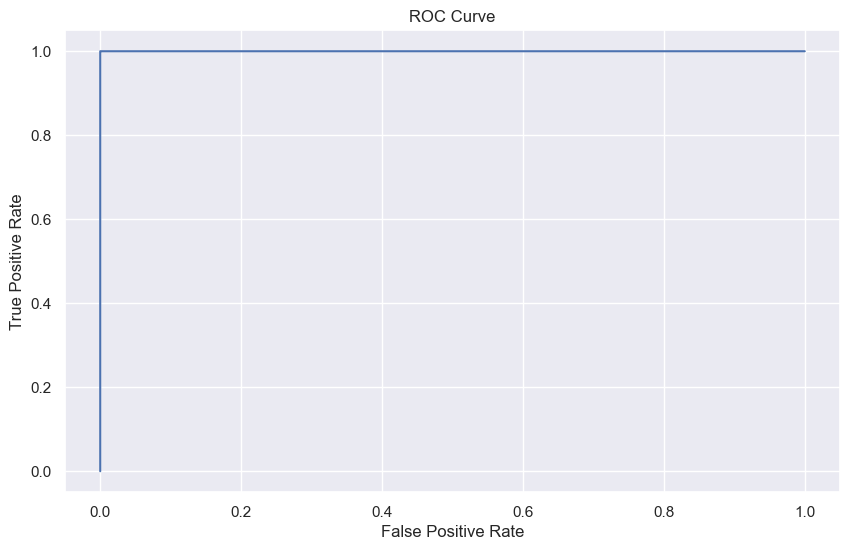

AUC: 0.9999999997837464
Optimal Threshold: 0.749661191927448


In [ ]:
from sklearn.metrics import roc_curve, roc_auc_score

predicted_probabilities = subset['pre3(probability)']

fpr, tpr, thresholds = roc_curve(subset['RainTomorrow'], predicted_probabilities)

import matplotlib.pyplot as plt
plt.plot(fpr, tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

auc = roc_auc_score(subset['RainTomorrow'], predicted_probabilities)
print('AUC:', auc)

optimal_threshold_index = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_threshold_index]
print('Optimal Threshold:', optimal_threshold)

predicted_labels = (predicted_probabilities >= optimal_threshold).astype(int)


In [ ]:
# Let's calculate accuracy

In [ ]:
accuracy = (predicted_labels == subset['RainTomorrow']).sum() / len(subset['RainTomorrow'])

print('Accuracy:', accuracy)


Accuracy: 0.9999939964819384


In [ ]:
num_1_t = (y_test == 1).sum()
num_0_t = (y_test == 0).sum()

In [ ]:
X_test['pre1(log-odds)'] = np.log(num_1_t / num_0_t)
X_test['pre1(probability)'] = 1 / (1 + np.exp(-np.log(num_1_t / num_0_t)))

# Iteration 2
X_test['leaf_entry1'] = model2.apply(X_test[var])
X_test['pre2(log-odds)'] = X_test['pre1(log-odds)'] + X_test['leaf_entry1'].apply(return_logs)
X_test['pre2(probability)'] = 1 / (1 + np.exp(-X_test['pre2(log-odds)']))

# Iteration 3
X_test['leaf_entry2'] = reg2.apply(X_test[var])
X_test['pre3(log-odds)'] = X_test['pre1(log-odds)'] + X_test['pre2(log-odds)'] + X_test['leaf_entry2'].apply(return_logs)
X_test['pre3(probability)'] = 1 / (1 + np.exp(-X_test['pre3(log-odds)']))

In [ ]:
predicted_probabilities_test = X_test['pre3(probability)']
optimal_threshold =  0.749661191927448
predicted_labels_test = (predicted_probabilities_test >= optimal_threshold).astype(int)

In [ ]:
# y_test

In [ ]:
# predicted_labels_test

In [ ]:
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(y_test, predicted_labels_test)
print("Accuracy:", accuracy)

Accuracy: 0.778393351800554


In [ ]:
# X_test

In [ ]:
# num_1_t = (y_test == 1).sum()
# num_1_t

In [ ]:
# num_0_t = (y_test == 0).sum()
# num_0_t

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_predict
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression

In [ ]:
df3=df_concatenated.copy()

In [ ]:
xx=df3[var]
yy=df3['RainTomorrow']

In [ ]:
classifiers = {
    "Support Vector Machine": SVC(),
    "Logistic Regression": LogisticRegression(),
}


classifier_names = {"Support Vector Machine": "SVC", "Logistic Regression": "LR"}

def kfold_indices(data, k):
    fold_size = len(data) // k
    indices = np.arange(len(data))
    folds = []
    for i in range(k):
        test_indices = indices[i * fold_size: (i + 1) * fold_size]
        train_indices = np.concatenate([indices[:i * fold_size], indices[(i + 1) * fold_size:]])
        folds.append((train_indices, test_indices))
    return folds

k = 5
predictions_df = pd.DataFrame()

for clf_name, clf in classifiers.items():
    print(f"Processing {clf_name}...")
    fold_predictions = []
    fold_indices = []

    for train_indices, test_indices in kfold_indices(xx, k):
        X_train_fold, X_test_fold = xx.iloc[train_indices], xx.iloc[test_indices]
        y_train_fold, y_test_fold = yy.iloc[train_indices], yy.iloc[test_indices]

        clf.fit(X_train_fold, y_train_fold)

        fold_pred = clf.predict(X_test_fold)
        fold_predictions.append(fold_pred)

        fold_indices.extend(X_test_fold.index)

    predictions_df[classifier_names[clf_name] + "_pred"] = np.concatenate(fold_predictions)
    predictions_df.index = fold_indices

print(predictions_df)


Processing Support Vector Machine...
Processing Logistic Regression...


C:\Users\Dell\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\Dell\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\Dell\anaconda3\Lib\site-packages\sk

        SVC_pred  LR_pred
0              1        1
1              1        1
2              1        1
3              1        1
4              1        1
...          ...      ...
175330         1        1
175331         1        1
175332         1        1
175333         1        1
175334         1        1

[175335 rows x 2 columns]


C:\Users\Dell\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [ ]:
print(predictions_df.shape)
print(yy.shape)

(175335, 2)
(175336,)


In [ ]:
indices_not_common = xx.index.difference(predictions_df.index)

print(indices_not_common)

Int64Index([175335], dtype='int64')


In [ ]:
y_train_aligned = yy.drop(indices_not_common)

df_combined = pd.concat([predictions_df, y_train_aligned], axis=1)

print(df_combined)


        SVC_pred  LR_pred  RainTomorrow
0              1        1             0
1              1        1             0
2              1        1             1
3              1        1             1
4              1        1             0
...          ...      ...           ...
175330         1        1             1
175331         1        1             1
175332         1        1             1
175333         1        1             1
175334         1        1             1

[175335 rows x 3 columns]


In [ ]:
xt=df_combined.drop(["RainTomorrow"],axis=1)
yt=df_combined["RainTomorrow"]

In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [ ]:
modelm=DecisionTreeClassifier()

In [ ]:
modelm.fit(xt,yt)

DecisionTreeClassifier()

In [ ]:
base_models = {
    "SVC_Pred": SVC(),
    "LR_Pred": LogisticRegression()
}

In [ ]:
X_test

,Location,Rainfall,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,RainToday,Year,...,Morning_temp,New_pressure,pre1(log-odds),pre1(probability),leaf_entry1,pre2(log-odds),pre2(probability),leaf_entry2,pre3(log-odds),pre3(probability)
34349,38,-0.041343,0.738649,12,2.364290,1.405861,-0.200740,0.122588,1,4,...,-0.399728,-0.269597,-1.256328,0.221607,16390,-0.116328,0.470951,13747,-2.512656,0.074976
95693,39,-0.277606,1.033239,2,2.364290,2.087830,-0.882669,-0.406075,0,8,...,1.046488,0.833388,-1.256328,0.221607,11154,-2.396328,0.083453,9102,-4.792656,0.008222
119511,32,-0.041343,-0.366068,14,-0.786671,-0.640043,1.058204,0.026467,1,7,...,-0.019803,-0.007404,-1.256328,0.221607,14867,-2.396328,0.083453,12415,-2.512656,0.074976
80961,44,-0.277606,-0.660658,0,-1.124274,-0.867366,1.635221,0.555130,0,10,...,-0.826499,0.034959,-1.256328,0.221607,18281,-0.116328,0.470951,15492,-2.512656,0.074976
54300,23,-0.041343,0.885944,15,1.126413,-0.867366,0.691012,-0.069653,1,8,...,-0.741277,0.717779,-1.256328,0.221607,15396,-2.396328,0.083453,12878,-4.792656,0.008222
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94239,39,-0.277606,-0.366068,9,0.113604,0.837555,0.061540,0.459009,0,4,...,0.380222,-0.029559,-1.256328,0.221607,19151,NaN,NaN,16289,NaN,NaN
50555,40,-0.277606,-1.028897,14,-1.349342,-1.094689,0.271364,-0.934737,0,6,...,-1.387331,1.858196,-1.256328,0.221607,2954,NaN,NaN,1998,NaN,NaN
13559,21,-0.277606,-0.734306,4,0.113604,-1.662995,-0.358109,-1.126978,0,6,...,0.442685,0.394148,-1.256328,0.221607,1065,NaN,NaN,570,NaN,NaN
81830,12,-0.041343,0.738649,14,-0.111465,0.382909,1.635221,1.179912,1,4,...,-0.617239,-0.112827,-1.256328,0.221607,26645,NaN,NaN,23379,NaN,NaN


In [ ]:
X_test[var]

,Location,Rainfall,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,RainToday,Year,Month,Morning_temp,New_pressure
34349,38,-0.041343,0.738649,12,2.364290,1.405861,-0.200740,0.122588,1,4,4,-0.399728,-0.269597
95693,39,-0.277606,1.033239,2,2.364290,2.087830,-0.882669,-0.406075,0,8,9,1.046488,0.833388
119511,32,-0.041343,-0.366068,14,-0.786671,-0.640043,1.058204,0.026467,1,7,4,-0.019803,-0.007404
80961,44,-0.277606,-0.660658,0,-1.124274,-0.867366,1.635221,0.555130,0,10,4,-0.826499,0.034959
54300,23,-0.041343,0.885944,15,1.126413,-0.867366,0.691012,-0.069653,1,8,3,-0.741277,0.717779
...,...,...,...,...,...,...,...,...,...,...,...,...,...
94239,39,-0.277606,-0.366068,9,0.113604,0.837555,0.061540,0.459009,0,4,7,0.380222,-0.029559
50555,40,-0.277606,-1.028897,14,-1.349342,-1.094689,0.271364,-0.934737,0,6,4,-1.387331,1.858196
13559,21,-0.277606,-0.734306,4,0.113604,-1.662995,-0.358109,-1.126978,0,6,4,0.442685,0.394148
81830,12,-0.041343,0.738649,14,-0.111465,0.382909,1.635221,1.179912,1,4,4,-0.617239,-0.112827


In [ ]:
base_model_predictions = {}
for model_name, model in base_models.items():
    model.fit(xx, yy)
    predictions = model.predict(X_test[var])
    base_model_predictions[model_name] = predictions

base_model_predictions_df = pd.DataFrame(base_model_predictions)


C:\Users\Dell\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [ ]:
# base_model_predictions_df

In [ ]:
base_model_predictions_df = base_model_predictions_df.rename(columns={'LR_Pred': 'LR_pred', 'SVC_Pred': 'SVC_pred'})

In [ ]:
metamodel_predictions = modelm.predict(base_model_predictions_df)

In [ ]:
from sklearn.metrics import accuracy_score

In [ ]:
metamodel_accuracy = accuracy_score(y_test, metamodel_predictions)
print("Metamodel Accuracy:", metamodel_accuracy)

Metamodel Accuracy: 0.7704737552382982
